# Projeto final de text mining - autenticidade de textos gerados por humanos vs autogerados por IA

### **Índice**

**1** - Introdução

**2** - Imports

**3** - Carregamento do dataset

**4** - Limpeza e pré-processamento

**5** - EDA

**6** - Split do dataset (treino/teste)

**7** - Modelo 1 - Bag of Words + Regressão Logística

**8** - Modelo 2 - TF-IDF + LinearSVC

**9** - Modelo 3 - TF-IDF + Naive Bayes

**10** - Modelo 4 - Word2Vec + Regressão linear

**11** - Modelo 5 - XGBClassifier

**12** - Modelo 6 - Rede Neuronal

**13** - Avaliação de modelos e comparação de resultados

**14** - Análise de sensibilidade dos modelos

**15** - Gráficos de treino/teste dos modelos

**16** - Função de avaliação de texto com input do utilizador

**17** - Guardar gráficos, tabelas impressas e modelos

**18** - Função extra de plot de top 200 para fases seguintes

**19** - Dashboards interativos do estudo e funcionalidades de classificação de texto de utilizador/web

**20** - Classificação de texto do utilizador e de webscrapping

**21** - Conclusão geral

**22** - Limitações e estudo futuro

**23** - Bibliografia

### **Introdução**

Vivemos numa era em que os modelos de machine learning são capazes de autogerar texto quase indistinguível da escrita humana. Esta realidade, ao mesmo tempo fascinante e desafiante para uns, para outros, levanta questões sobre autenticidade, ética e confiança na informação. O presente projeto insere-se no âmbito da unidade curricular de Text Mining e tem como objetivo explorar técnicas de processamento de linguagem natural e aprendizagem automática para distinguir entre texto escrito por humanos e texto gerado por modelos de IA como os LLM´s. Para esse efeito, recorremos ao dataset “AI vs Human Text” do Kaggle link: https://www.kaggle.com/datasets/shanegerami/ai-vs-human-text, que oferece uma base sólida de exemplos reais para treino e avaliação. O trabalho inclui todo o pipeline típico de mineração de texto: desde o pré-processamento e limpeza dos dados, até à vetorização e construção de modelos de classificação. Serão aplicadas abordagens supervisionadas, não supervisionadas e uma componente adicional baseada em deep learning, respondendo assim às exigências da unidade curricular e à dimensão do grupo de trabalho. A avaliação será suportada por métricas rigorosas como , exatidão, precisão, recall e F1-score, complementadas por visualizações interativas. Finalmente, o projeto culminará no desenvolvimento de uma aplicação interativa que, para além de apresentar resultados de treino, permitirá ao utilizador introduzir novo texto e receber de forma imediata uma classificação fundamentada.

### **Imports**

Nesta secção são instalados, caso necessário, os pacotes utilizados no projeto e, de seguida, são importadas todas as bibliotecas que serão utilizadas ao longo do projeto.

In [1]:
#%pip install numpy
#%pip install pandas
#%pip install matplotlib
#%pip install seaborn
#%pip install tqdm
#%pip install joblib
#%pip install wordcloud

# NLP
#%pip install nltk
#%pip install gensim
#%pip install spacy
#!python -m spacy download en_core_web_sm

# Machine Learning (sklearn)
#%pip install scikit-learn

# Deep Learning
#%pip install tensorflow

# Modelos avançados
#%pip install xgboost
#%pip install shap
#%pip install plotly kaleido duckduckgo_search newspaper3k textstat

In [2]:

# SISTEMA / UTILIDADES

try:
    import os
    print("[OK] os importado.")
except Exception as e:
    print("[ERRO] os:", e)

try:
    import re
    print("[OK] re importado.")
except Exception as e:
    print("[ERRO] re:", e)

try:
    import string
    print("[OK] string importado.")
except Exception as e:
    print("[ERRO] string:", e)

try:
    import itertools
    print("[OK] itertools importado.")
except Exception as e:
    print("[ERRO] itertools:", e)

try:
    import warnings
    warnings.filterwarnings("ignore")
    print("[OK] warnings importado.")
except Exception as e:
    print("[ERRO] warnings:", e)

try:
    import joblib
    print("[OK] joblib importado.")
except Exception as e:
    print("[ERRO] joblib:", e)

try:
    from collections import Counter
    print("[OK] Counter importado.")
except Exception as e:
    print("[ERRO] Counter:", e)

try:
    from tqdm import tqdm
    print("[OK] tqdm importado.")
except Exception as e:
    print("[ERRO] tqdm:", e)

# NUMPY / PANDAS

try:
    import numpy as np
    print("[OK] numpy importado.")
except Exception as e:
    print("[ERRO] numpy:", e)

try:
    import pandas as pd
    print("[OK] pandas importado.")
except Exception as e:
    print("[ERRO] pandas:", e)

# VISUALIZAÇÃO

try:
    import matplotlib.pyplot as plt
    print("[OK] matplotlib.pyplot importado.")
except Exception as e:
    print("[ERRO] matplotlib:", e)

try:
    import seaborn as sns
    print("[OK] seaborn importado.")
except Exception as e:
    print("[ERRO] seaborn:", e)

try:
    from wordcloud import WordCloud
    print("[OK] WordCloud importado.")
except Exception as e:
    print("[ERRO] WordCloud:", e)

try:
    plt.rcParams["figure.figsize"] = (6, 4)
    plt.rcParams["figure.dpi"] = 120
    print("[OK] Configurações de gráficos aplicadas.")
except Exception as e:
    print("[ERRO] Configurações de gráficos:", e)

# PLOTLY

try:
    import plotly.graph_objects as go
    print("[OK] plotly.graph_objects importado.")
except Exception as e:
    print("[ERRO] plotly.graph_objects:", e)

try:
    from plotly.subplots import make_subplots
    print("[OK] make_subplots importado.")
except Exception as e:
    print("[ERRO] plotly.subplots:", e)

try:
    import plotly.io as pio
    print("[OK] plotly.io importado.")
except Exception as e:
    print("[ERRO] plotly.io:", e)


# IPython DISPLAY

try:
    from IPython.display import display, HTML
    print("[OK] display, HTML importados.")
except Exception as e:
    print("[ERRO] IPython.display:", e)

# SKLEARN (ML CLÁSSICO)

try:
    from sklearn.model_selection import train_test_split, GridSearchCV
    print("[OK] train_test_split, GridSearchCV importados.")
except Exception as e:
    print("[ERRO] sklearn.model_selection:", e)

try:
    from sklearn.metrics import (
        accuracy_score, precision_score, recall_score,
        f1_score, classification_report, confusion_matrix,
        ConfusionMatrixDisplay, PrecisionRecallDisplay,
        roc_curve, roc_auc_score
    )
    print("[OK] sklearn.metrics importado.")
except Exception as e:
    print("[ERRO] sklearn.metrics:", e)

try:
    from sklearn.pipeline import Pipeline
    print("[OK] Pipeline importado.")
except Exception as e:
    print("[ERRO] Pipeline:", e)

try:
    from sklearn.feature_extraction.text import (
        CountVectorizer, TfidfVectorizer, ENGLISH_STOP_WORDS
    )
    print("[OK] Vectorizers importados.")
except Exception as e:
    print("[ERRO] sklearn.feature_extraction.text:", e)

try:
    from sklearn.linear_model import LogisticRegression
    print("[OK] LogisticRegression importado.")
except Exception as e:
    print("[ERRO] LogisticRegression:", e)

try:
    from sklearn.svm import LinearSVC
    print("[OK] LinearSVC importado.")
except Exception as e:
    print("[ERRO] LinearSVC:", e)

try:
    from sklearn.naive_bayes import MultinomialNB
    print("[OK] MultinomialNB importado.")
except Exception as e:
    print("[ERRO] MultinomialNB:", e)

# NLP (NLTK / GENSIM / SPACY / TEXTSTAT / NEWSPAPER)

try:
    import nltk
    print("[OK] nltk importado.")
except Exception as e:
    print("[ERRO] nltk:", e)

try:
    from nltk.corpus import stopwords
    print("[OK] stopwords importado.")
except Exception as e:
    print("[ERRO] stopwords:", e)

try:
    from nltk.stem import SnowballStemmer
    print("[OK] SnowballStemmer importado.")
except Exception as e:
    print("[ERRO] SnowballStemmer:", e)

try:
    from gensim.models import Word2Vec
    print("[OK] Word2Vec importado.")
except Exception as e:
    print("[ERRO] Word2Vec:", e)

try:
    from gensim.utils import simple_preprocess
    print("[OK] simple_preprocess importado.")
except Exception as e:
    print("[ERRO] simple_preprocess:", e)

try:
    import spacy
    print("[OK] spacy importado.")
except Exception as e:
    print("[ERRO] spacy:", e)

try:
    import textstat
    print("[OK] textstat importado.")
except Exception as e:
    print("[ERRO] textstat:", e)

try:
    from newspaper import Article
    print("[OK] Article (newspaper3k) importado.")
except Exception as e:
    print("[ERRO] newspaper.Article:", e)


# BUSCA / WEB SCRAPING

try:
    from duckduckgo_search import DDGS
    print("[OK] DDGS importado.")
except Exception as e:
    print("[ERRO] duckduckgo_search:", e)


# DEEP LEARNING (TENSORFLOW / KERAS)

try:
    import tensorflow as tf
    print("[OK] tensorflow importado.")
except Exception as e:
    print("[ERRO] tensorflow:", e)

try:
    from tensorflow.keras.models import Sequential
    print("[OK] Sequential importado.")
except Exception as e:
    print("[ERRO] Sequential:", e)

try:
    from tensorflow.keras.layers import Dense, Dropout, Input
    print("[OK] Dense, Dropout, Input importados.")
except Exception as e:
    print("[ERRO] keras.layers:", e)

try:
    from tensorflow.keras.callbacks import EarlyStopping
    print("[OK] EarlyStopping importado.")
except Exception as e:
    print("[ERRO] EarlyStopping:", e)

try:
    from tensorflow.keras.optimizers import Adam
    print("[OK] Adam importado.")
except Exception as e:
    print("[ERRO] Adam:", e)


# MODELOS AVANÇADOS (XGBoost / SHAP)

try:
    from xgboost import XGBClassifier
    print("[OK] XGBClassifier importado.")
except Exception as e:
    print("[ERRO] XGBClassifier:", e)

try:
    import shap
    print("[OK] shap importado.")
except Exception as e:
    print("[ERRO] shap:", e)


print("\nTodos os imports processados.")


[OK] os importado.
[OK] re importado.
[OK] string importado.
[OK] itertools importado.
[OK] warnings importado.
[OK] joblib importado.
[OK] Counter importado.
[OK] tqdm importado.
[OK] numpy importado.
[OK] pandas importado.
[OK] matplotlib.pyplot importado.
[OK] seaborn importado.
[OK] WordCloud importado.
[OK] Configurações de gráficos aplicadas.
[OK] plotly.graph_objects importado.
[OK] make_subplots importado.
[OK] plotly.io importado.
[OK] display, HTML importados.
[OK] train_test_split, GridSearchCV importados.
[OK] sklearn.metrics importado.
[OK] Pipeline importado.
[OK] Vectorizers importados.
[OK] LogisticRegression importado.
[OK] LinearSVC importado.
[OK] MultinomialNB importado.
[OK] nltk importado.
[OK] stopwords importado.
[OK] SnowballStemmer importado.
[OK] Word2Vec importado.
[OK] simple_preprocess importado.
[OK] spacy importado.
[OK] textstat importado.
[OK] Article (newspaper3k) importado.
[OK] DDGS importado.

[OK] tensorflow importado.
[OK] Sequential importado.
[

### **Carregamento dos dados**

Nesta etapa é definido qual o ficheiro de dados que será utilizado no projeto.  
Existe a possibilidade de trabalhar com:

- o **dataset original**;
- o **dataset limpo** (previamente processado);
- ou um **subset de debug** (mais pequeno), utilizado apenas para acelerar testes e desenvolvimento.

Opcionalmente, pode também ser criado um novo subset do dataset completo, limitando o número de exemplos por classe. Este controlo é feito através das variáveis `FAST_MODE`, `USE_DEBUG_DATASET` e `N_PER_CLASS`.


In [3]:
# Caminhos para os ficheiros
original_path = "data/AI_Human.csv"                     # dataset original
clean_path    = "data_cleaned/AI_Human_sample_cleaned.csv"  # dataset limpo (completo)
debug_path    = "data_debug/AI_Human_debug_subset.csv"      # subset de debug (pequeno)

# Parâmetros de controlo
# FAST_MODE:
#   - True  → cria um novo subset a partir do dataset completo
#   - False → ignora esta etapa
# USE_DEBUG_DATASET:
#   - True  → utiliza um subset mais pequeno (debug), já criado, para acelerar testes
#   - False → utiliza o dataset completo
# N_PER_CLASS:
#   - número máximo de exemplos por classe (usado apenas em FAST_MODE)
FAST_MODE = False
USE_DEBUG_DATASET = False
N_PER_CLASS = 225000

print("A iniciar carregamento do dataset...")

# Escolha da fonte de dados
if USE_DEBUG_DATASET and os.path.exists(debug_path):
    print("A carregar subset de debug:", debug_path)
    df = pd.read_csv(debug_path)
else:
    if os.path.exists(clean_path):
        print("A carregar dataset limpo final:", clean_path)
        df = pd.read_csv(clean_path)
    else:
        print("Dataset limpo final não encontrado. A carregar dataset original:", original_path)
        df = pd.read_csv(original_path)

    # Garantir que a coluna 'generated' está no formato correto
    df["generated"] = df["generated"].astype(int)
    print("Shape do df carregado (antes de FAST_MODE):", df.shape)

    # FAST_MODE: criar subset menor -> opcional para correr rapidamente o notebook
    if FAST_MODE:
        print(f"FAST_MODE ativo: a amostrar no máximo {N_PER_CLASS} textos por classe.")
        df = (
            df.groupby("generated", group_keys=False)
              .apply(lambda x: x.sample(min(len(x), N_PER_CLASS), random_state=2))
              .reset_index(drop=True)
        )
        print("Novo shape do df (subset):", df.shape)

        # Guardar subset de debug
        os.makedirs("data_debug", exist_ok=True)
        df.to_csv(debug_path, index=False, encoding="utf-8")
        print(f"Subset de debug guardado em: {debug_path}")

# Garantir que a coluna target tem tipo inteiro
if "generated" in df.columns:
    df["generated"] = df["generated"].astype(int)
else:
    raise KeyError("Coluna 'generated' não encontrada no dataset.")

print("Shape final do df em uso:", df.shape)
display(df.head(3))

A iniciar carregamento do dataset...
A carregar dataset limpo final: data_cleaned/AI_Human_sample_cleaned.csv
Shape do df carregado (antes de FAST_MODE): (487235, 3)
Shape final do df em uso: (487235, 3)


,text,generated,clean_text
0,Cars. Cars have been around since they became ...,0,car car famous henri ford creat built modelt c...
1,Transportation is a large necessity in most co...,0,transport larg necess countri worldwid doubt c...
2,"""America's love affair with it's vehicles seem...",0,america love affair vehicl cool say elisabeth ...


### Verificação da existência de texto limpo

Antes de aplicar novamente o pré-processamento, é verificado se já existe uma coluna `clean_text` no dataset.  
Caso essa coluna já esteja presente e contenha valores válidos, a etapa de limpeza é ignorada, evitando repetir um processo demorado e tornando a execução do código mais eficiente.

In [4]:
if "clean_text" in df.columns and df["clean_text"].notna().sum() > 10:
    print("A coluna 'clean_text' já existe. A limpeza será ignorada.")
    skip_cleaning = False
else:
    print("A coluna 'clean_text' não existe ou está incompleta. A limpeza será aplicada.")
    skip_cleaning = False

A coluna 'clean_text' já existe. A limpeza será ignorada.


### **Limpeza e pré-processamento**

Nesta etapa é definida a função `clean_text_english`, responsável por normalizar o texto presente no dataset.  
O objetivo é reduzir o ruído presente nos dados e tornar os textos mais uniformes e consistentes para a fase de análise e modelação.

As principais operações realizadas são:
- Conversão de todo o texto para minúsculas
- Remoção de números, pontuação e espaços extra
- Remoção de palavras muito curtas e stopwords
- Aplicação de stemming (redução das palavras à sua raiz)

De seguida, é apresentada uma pequena demonstração do efeito da limpeza em alguns exemplos e, caso seja necessário, a função é aplicada a todo o dataset para criar a coluna `clean_text`.

In [5]:
# Garantir que o corpus de stopwords do NLTK está disponível
nltk.download("stopwords")

# Regex para limpeza
_regex_punct = re.compile(rf"[{re.escape(string.punctuation)}]")
_regex_num = re.compile(r"\d+")
_regex_space = re.compile(r"\s+")

# Stemmer
stemmer = SnowballStemmer("english")

# Stopwords combinadas (NLTK + sklearn)
STOPWORDS = set(stopwords.words("english")).union(ENGLISH_STOP_WORDS)

def clean_text_english(s: str) -> str:
    """
    Função para limpeza e normalização do texto:
    - converte para minúsculas
    - remove números e pontuação
    - remove espaços em excesso
    - remove stopwords e palavras muito curtas
    - aplica stemming
    - aplica segunda filtragem de stopwords após stemming
    """
    if not isinstance(s, str):
        s = str(s)

    s = s.lower()
    s = _regex_num.sub(" ", s)
    s = _regex_punct.sub(" ", s)
    s = _regex_space.sub(" ", s).strip()

    tokens = s.split()
    # primeira filtragem antes do stemming
    tokens = [t for t in tokens if len(t) > 2 and t not in STOPWORDS]
    # aplica stemming
    tokens = [stemmer.stem(t) for t in tokens]
    # segunda filtragem (remove versões stemmed que ainda sejam stopwords)
    tokens = [t for t in tokens if t not in STOPWORDS]

    return " ".join(tokens)

# Demonstração com 2 exemplos de limpeza
for i in range(2):
    print("RAW:", df["text"].iloc[i][:120].replace("\n"," "))
    print("CLEAN:", clean_text_english(df["text"].iloc[i])[:120], "\n")

# Aplicação da limpeza ao dataset (sempre executada, sem skip_cleaning)
print("A aplicar limpeza ao texto... Isto pode demorar alguns minutos.")

tqdm.pandas()
df["clean_text"] = df["text"].astype(str).progress_apply(clean_text_english)

print("Limpeza concluída!")
display(df[["text","clean_text","generated"]].head(3))


[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\iliei\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


RAW: Cars. Cars have been around since they became famous in the 1900s, when Henry Ford created and built the first ModelT. C
CLEAN: car car famous henri ford creat built modelt car play major role day live peopl start question limit car usag good thing 

RAW: Transportation is a large necessity in most countries worldwide. With no doubt, cars, buses, and other means of transpor
CLEAN: transport larg necess countri worldwid doubt car buse mean transport make place place easier faster negat pollut mobil t 

A aplicar limpeza ao texto... Isto pode demorar alguns minutos.


100%|█████████████████████████████████████████████████████████████████████████| 487235/487235 [22:56<00:00, 353.90it/s]


Limpeza concluída!


,text,clean_text,generated
0,Cars. Cars have been around since they became ...,car car famous henri ford creat built modelt c...,0
1,Transportation is a large necessity in most co...,transport larg necess countri worldwid doubt c...,0
2,"""America's love affair with it's vehicles seem...",america love affair vehicl cool say elisabeth ...,0


### Guardar cópia do dataset limpo

Após a criação da coluna `clean_text`, é gerada uma cópia do dataset já tratado, de forma a evitar repetir a etapa de limpeza em execuções futuras.

Esta cópia só é guardada quando está a ser utilizado o dataset completo, garantindo que o subset de debug não sobrescreve a versão final do dataset limpo.

In [6]:
# Guardar dataset limpo (apenas se estiver a ser usado o dataset completo)
os.makedirs("data_cleaned", exist_ok=True)

clean_path = "data_cleaned/AI_Human_sample_cleaned.csv"

if not USE_DEBUG_DATASET:
    df.to_csv(clean_path, index=False, encoding="utf-8")
    print(f"Dataset limpo guardado em: {clean_path}")
else:
    print("USE_DEBUG_DATASET = True → o dataset limpo final não será sobrescrito.")

print(f"Tamanho do dataset atual: {df.shape}")

Dataset limpo guardado em: data_cleaned/AI_Human_sample_cleaned.csv
Tamanho do dataset atual: (487235, 3)


### **EDA**

Nesta secção é feita uma análise exploratória ao dataset, com o objetivo de:
- perceber a distribuição da variável alvo (texto humano vs IA);
- analisar o comprimento dos textos;
- identificar padrões lexicais (palavras mais frequentes e mais características);
- extrair algumas propriedades linguísticas (POS tagging e entidades nomeadas);
- avaliar a diversidade lexical dos textos.

Ao longo da secção são apresentados gráficos e tabelas, seguidos de breves conclusões.

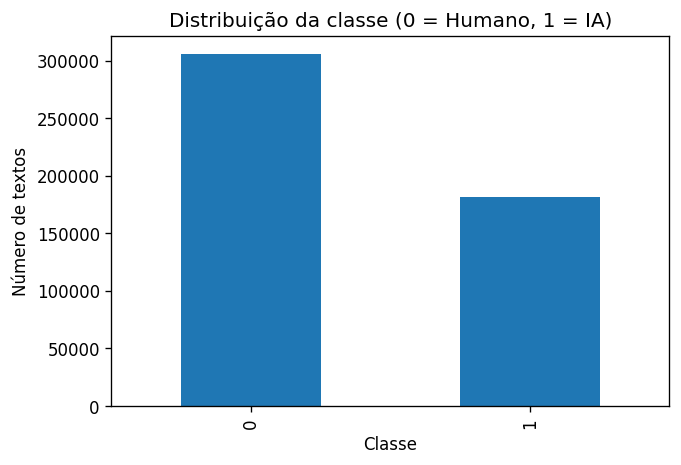

In [7]:
#Distribuição da variável alvo

# Nº de tokens com base no texto limpo
df["n_tokens"] = df["clean_text"].apply(lambda s: len(str(s).split()))

# Distribuição da classe (0 = Humano, 1 = IA)
fig, ax = plt.subplots()
df["generated"].value_counts().sort_index().plot(kind="bar", ax=ax)
ax.set_title("Distribuição da classe (0 = Humano, 1 = IA)")
ax.set_xlabel("Classe")
ax.set_ylabel("Número de textos")
plt.show()

**Conclusões:**

O dataset apresenta uma distribuição perfeitamente equilibrada entre textos humanos (0) e textos gerados por IA (1).

Este equilíbrio é ideal para a fase de modelação, uma vez que reduz o risco de enviesamento do modelo em direção a uma das classes.

Estatísticas do número de tokens por classe:


,count,mean,std,min,25%,50%,75%,max
generated,,,,,,,,
0,305797.0,175.462127,82.564571,6.0,114.0,160.0,218.0,850.0
1,181438.0,169.690947,68.198362,0.0,125.0,163.0,201.0,738.0


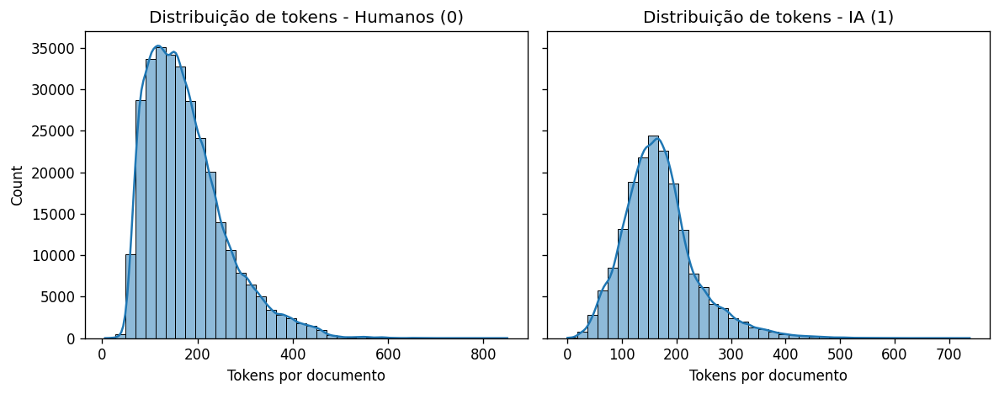

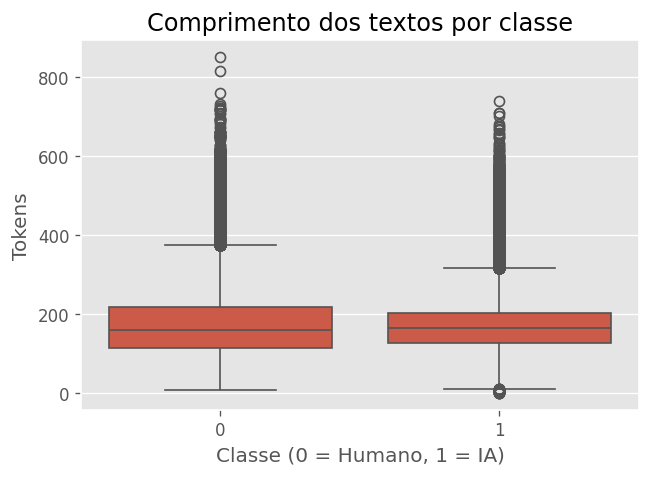

In [8]:
# Comrpimento dos textos (tabela + histogramas + boxplots)

# Estatísticas de nº tokens por classe
print("Estatísticas do número de tokens por classe:")
display(df.groupby("generated")["n_tokens"].describe())

# Histogramas separados por classe
fig, axes = plt.subplots(1, 2, figsize=(10,4), sharey=True)

sns.histplot(df[df["generated"] == 0]["n_tokens"], bins=40, kde=True, ax=axes[0])
axes[0].set_title("Distribuição de tokens - Humanos (0)")
axes[0].set_xlabel("Tokens por documento")

sns.histplot(df[df["generated"] == 1]["n_tokens"], bins=40, kde=True, ax=axes[1])
axes[1].set_title("Distribuição de tokens - IA (1)")
axes[1].set_xlabel("Tokens por documento")

plt.style.use("ggplot")
plt.tight_layout()
plt.show()

# Boxplots
fig, ax = plt.subplots()
sns.boxplot(data=df, x="generated", y="n_tokens", ax=ax)
ax.set_title("Comprimento dos textos por classe")
ax.set_xlabel("Classe (0 = Humano, 1 = IA)")
ax.set_ylabel("Tokens")
plt.show()

**Conclusões:**

Os textos escritos por humanos tendem a ser mais longos e a apresentar maior variabilidade no número de tokens, enquanto os textos gerados por IA são, em geral, mais curtos e mais homogéneos em termos de comprimento.

Esta diferença indica que o tamanho do texto pode ser uma feature relevante no processo de distinção entre textos humanos e textos gerados por IA.

In [9]:
# Tokens mais frequentes por classe

def top_tokens(class_value, n=20):
    #Devolve DataFrame com os n tokens mais frequentes em cada classe.
    tokens = " ".join(df[df["generated"] == class_value]["clean_text"]).split()
    counter = Counter(tokens)
    return pd.DataFrame(counter.most_common(n), columns=["token", "count"])

top_human = top_tokens(0, 20)
top_ai = top_tokens(1, 20)

print("Top 20 tokens mais frequentes — Humanos (classe 0):")
display(top_human)

print("Top 20 tokens mais frequentes — IA (classe 1):")
display(top_ai)

Top 20 tokens mais frequentes — Humanos (classe 0):


,token,count
0,student,1168123
1,car,918121
2,peopl,899487
3,school,636232
4,help,508824
5,make,494811
6,vote,487332
7,elector,484968
8,like,482596
9,time,449337


Top 20 tokens mais frequentes — IA (classe 1):


,token,count
0,student,421332
1,car,321403
2,peopl,273118
3,like,260145
4,help,258864
5,make,240221
6,elector,234834
7,colleg,205404
8,learn,202539
9,state,201249


**Conclusões:**

A análise dos tokens mais frequentes mostra que ambas as classes utilizam maioritariamente palavras muito comuns na língua inglesa, como artigos, pronomes, preposições e verbos auxiliares (ex.: “the”, “and”, “that”, “you”, “have”).

Apesar desta semelhança geral, observam-se diferenças ligeiras nas frequências relativas de alguns termos. Certos tokens surgem com maior predominância em textos humanos (ex.: “you”, “they”, “school”), enquanto outros aparecem com maior regularidade em textos gerados por IA (ex.: “more”, “help”, “our”).

Estas variações, embora subtis, podem contribuir como informação complementar na fase de classificação.

In [10]:
# Tokens mais característicos (diferença IA vs Humano)

def distinctive_tokens():
    #Compara frequências e calcula tokens mais 'característicos' de cada classe.
    human_counts = Counter(" ".join(df[df["generated"] == 0]["clean_text"]).split())
    ai_counts = Counter(" ".join(df[df["generated"] == 1]["clean_text"]).split())

    all_words = set(human_counts.keys()) | set(ai_counts.keys())
    rows = []
    for w in all_words:
        rows.append({
            "token": w,
            "freq_human": human_counts[w],
            "freq_ai": ai_counts[w],
            "diff_ai_human": ai_counts[w] - human_counts[w]  # >0 → mais IA, <0 → mais humano
        })
    diff_df = pd.DataFrame(rows).sort_values("diff_ai_human", ascending=False)
    return diff_df

distinct = distinctive_tokens()

print("Tokens mais característicos da IA:")
display(distinct.head(20))

print("Tokens mais característicos de Humanos:")
display(distinct.sort_values("diff_ai_human").head(20))

Tokens mais característicos da IA:


,token,freq_human,freq_ai,diff_ai_human
56575,provid,42491,142862,100371
184691,import,101105,185636,84531
71729,potenti,17343,100288,82945
104735,addit,24183,103208,79025
134249,lead,59231,131292,72061
192812,reduc,66999,138696,71697
138095,individu,25907,92406,66499
186606,ensur,10972,77139,66167
54817,success,39297,104385,65088
82457,signific,7351,71048,63697


Tokens mais característicos de Humanos:


,token,freq_human,freq_ai,diff_ai_human
116863,student,1168123,421332,-746791
203504,peopl,899487,273118,-626369
176851,car,918121,321403,-596718
204575,school,636232,174998,-461234
80340,vote,487332,157436,-329896
149543,drive,343215,61931,-281284
169201,think,363245,85918,-277327
186260,want,315468,49704,-265764
142750,time,449337,189074,-260263
17843,make,494811,240221,-254590


**Conclusões:**

Os textos gerados por IA tendem a utilizar com maior frequência palavras associadas a uma escrita mais formal e expositiva, ligadas a explicação, conclusão e generalização (ex.: “import”, “develop”, “ensur”, “impact”, “success”).

Em contraste, os textos humanos apresentam maior presença de pronomes pessoais e termos relacionados com experiências, opiniões e contextos do quotidiano (ex.: “you”, “because”, “school”, “car”).

Esta diferença no tipo de vocabulário utilizado reforça a existência de padrões linguísticos distintos entre as duas classes, o que pode ser explorado como um bom indicador discriminativo.

In [11]:
# Análise morfossintática (POS Tagging)

# Carregar modelo do spaCy
nlp = spacy.load("en_core_web_sm")

def pos_features(text):
    """
    Extrai features morfossintáticas de um texto:
    - número total de tokens (spaCy)
    - proporção de verbos
    - proporção de substantivos
    - proporção de adjetivos
    """
    if not isinstance(text, str):
        text = str(text)

    doc = nlp(text)   # já garantimos que é string

    n_tokens = len(doc)
    n_verbs = sum(1 for t in doc if t.pos_ == "VERB")
    n_nouns = sum(1 for t in doc if t.pos_ == "NOUN")
    n_adjs  = sum(1 for t in doc if t.pos_ == "ADJ")

    return pd.Series({
        "n_tokens_spacy": n_tokens,
        "prop_verbs": n_verbs / n_tokens if n_tokens else 0,
        "prop_nouns": n_nouns / n_tokens if n_tokens else 0,
        "prop_adjs":  n_adjs  / n_tokens if n_tokens else 0,
    })

# Aplicar uma amostra, para reduzir tempo de processamento
N_POS = min(2000, len(df))
df_pos = df.sample(n=N_POS, random_state=42).copy()

print(f"A aplicar POS tagging a {len(df_pos)} textos...")

pos_df = df_pos["clean_text"].apply(pos_features)
df_pos = pd.concat([df_pos, pos_df], axis=1)

# Exemplo das features extraídas
print("Exemplo de POS features:")
display(df_pos[["text","n_tokens_spacy","prop_verbs","prop_nouns","prop_adjs","generated"]].head(3))

# Médias por classe
print("\nMédias das proporções de classes gramaticais por classe (0=Humano, 1=IA) [amostra]:")
display(df_pos.groupby("generated")[["prop_verbs","prop_nouns","prop_adjs"]].mean())

A aplicar POS tagging a 2000 textos...
Exemplo de POS features:


,text,n_tokens_spacy,prop_verbs,prop_nouns,prop_adjs,generated
419952,"Real or Fake Feelings\n\n""Imagine being able t...",200.0,0.160000,0.415000,0.080000,0
478535,Seeking multiple opinions can help you make be...,163.0,0.239264,0.472393,0.171779,0
133753,"ADDRESS_NAME\n\nFebruary 9, 2011\n\nDear TEACH...",106.0,0.179245,0.320755,0.094340,0



Médias das proporções de classes gramaticais por classe (0=Humano, 1=IA) [amostra]:


,prop_verbs,prop_nouns,prop_adjs
generated,,,
0,0.143829,0.482362,0.122682
1,0.135519,0.456724,0.138719


**Conclusões:**

Os textos gerados por IA apresentam, em média, uma proporção ligeiramente superior de substantivos e adjetivos, sugerindo uma escrita mais descritiva e informativa.

Por outro lado, a proporção de verbos é bastante semelhante nas duas classes, indicando que a estrutura verbal não é, por si só, um forte fator discriminativo.

Ainda que as diferenças sejam subtis, estas características podem ser úteis quando combinadas com outras métricas linguísticas.

In [12]:
# Named Entity Recognition (NER)

def count_entities(text):
    """
    Conta o número de entidades nomeadas (NER) presentes num texto.
    Utiliza o modelo spaCy carregado anteriormente (nlp).
    """
    if not isinstance(text, str):
        text = str(text)

    doc = nlp(text)
    return len(doc.ents)

# Aplicar uma amostra para reduzir o tempo de processamento
N_NER = min(2000, len(df))
df_ner = df.sample(n=N_NER, random_state=24).copy()

print(f"A aplicar NER a {len(df_ner)} textos...")

# Aplicar a função de contagem de entidades ao texto original
# (o texto limpo perderia maiúsculas, formas originais e poderia prejudicar o NER)
df_ner["n_entities"] = df_ner["text"].apply(count_entities)

# Mostrar alguns exemplos de textos com o respetivo nº de entidades nomeadas
print("Exemplo de nº de entidades nomeadas por texto:")
display(df_ner[["text","n_entities","generated"]].head(3))

# Estatísticas descritivas do nº de entidades por classe (0 = Humano, 1 = IA)
print("\nEstatísticas de entidades nomeadas por classe [amostra]:")
display(df_ner.groupby("generated")["n_entities"].describe())

A aplicar NER a 2000 textos...
Exemplo de nº de entidades nomeadas por texto:


,text,n_entities,generated
71832,Device Usage and Its Impact on Students’ Acade...,4,1
476204,Is Being while driving safe?\n\nThis essay Wix...,45,0
124056,"May 24, 2001 was the due it all started. When ...",37,0



Estatísticas de entidades nomeadas por classe [amostra]:


,count,mean,std,min,25%,50%,75%,max
generated,,,,,,,,
0,1224.0,16.861928,14.389616,0.0,7.0,14.0,23.0,129.0
1,776.0,11.760309,11.002136,0.0,3.0,8.0,18.0,66.0


**Conclusões:**

Os textos humanos apresentam, em média, um maior número de entidades nomeadas, bem como maior variabilidade neste valor, o que sugere uma maior referência a pessoas, locais, organizações e elementos concretos do mundo real.

Por contraste, os textos gerados por IA tendem a ser mais genéricos e menos ancorados em referências específicas.

Isto indica que o número de entidades nomeadas pode ser uma feature útil na distinção entre texto humano e texto gerado por IA.

Exemplo de diversidade lexical por texto:


,clean_text,lexical_diversity,repetition_ratio,generated
0,car car famous henri ford creat built modelt c...,0.569930,0.430070,0
1,transport larg necess countri worldwid doubt c...,0.627907,0.372093,0
2,america love affair vehicl cool say elisabeth ...,0.565217,0.434783,0



Médias de diversidade lexical e repetição por classe:


,lexical_diversity,repetition_ratio
generated,,
0,0.544717,0.455283
1,0.572690,0.427282


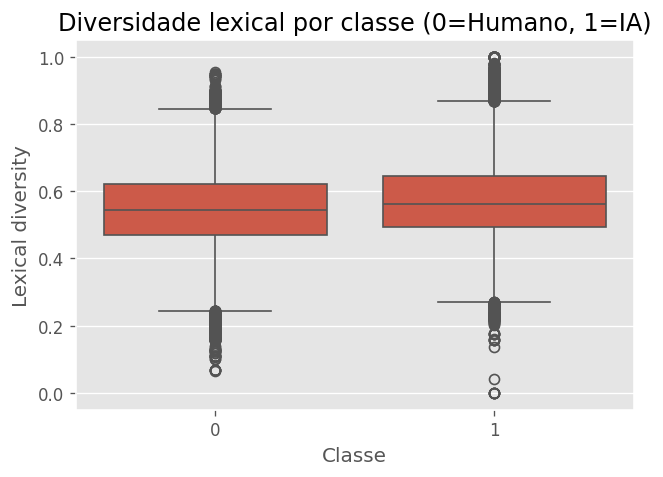

In [13]:
# Diversidade lexical e repetição

def lexical_metrics(clean_text):
    """
    Calcula métricas de diversidade lexical:
    - lexical_diversity: nº de tokens únicos / nº total de tokens
    - repetition_ratio: 1 - diversidade
    """
    tokens = str(clean_text).split()
    total = len(tokens)
    unique = len(set(tokens))
    if total == 0:
        return pd.Series({
            "lexical_diversity": 0.0,
            "repetition_ratio": 0.0
        })
    diversity = unique / total
    repetition = 1 - diversity
    return pd.Series({
        "lexical_diversity": diversity,
        "repetition_ratio": repetition
    })

# Aplicar ao texto limpo
lex_df = df["clean_text"].apply(lexical_metrics)
df[["lexical_diversity","repetition_ratio"]] = lex_df

# Exemplo dos valores calculados
print("Exemplo de diversidade lexical por texto:")
display(df[["clean_text","lexical_diversity","repetition_ratio","generated"]].head(3))

# Médias por classe
print("\nMédias de diversidade lexical e repetição por classe:")
display(df.groupby("generated")[["lexical_diversity","repetition_ratio"]].mean())

# Visualizaçãp: boxplots da diversidade lexical por classe
fig, ax = plt.subplots()
sns.boxplot(data=df, x="generated", y="lexical_diversity", ax=ax)
ax.set_title("Diversidade lexical por classe (0=Humano, 1=IA)")
ax.set_xlabel("Classe")
ax.set_ylabel("Lexical diversity")
plt.show()

**Conclusões:**

Os textos gerados por IA apresentam, em média, uma diversidade lexical ligeiramente superior, enquanto os textos humanos revelam uma taxa ligeiramente maior de repetição.

O boxplot confirma esta tendência, embora exista sobreposição entre as duas classes.

Apesar de a diferença não ser muito acentuada, esta métrica pode acrescentar valor quando combinada com outras características analisadas ao longo do EDA.

#### Conclusão geral do EDA

A análise exploratória permitiu identificar diferenças relevantes entre textos escritos por humanos e textos gerados por IA, tanto ao nível estrutural como linguístico.

O dataset apresenta um **equilíbrio perfeito entre classes**, garantindo condições adequadas para a construção de modelos de classificação sem enviesamento inicial.

Os textos humanos tendem a ser **mais longos e heterogéneos em termos de comprimento**, enquanto os textos gerados por IA são, em média, **mais curtos e mais uniformes**, o que indica que o número de tokens pode ser uma boa *feature* discriminativa.

A análise léxica revelou que, embora grande parte do vocabulário seja partilhado entre as duas classes, existem **diferenças subtis mas consistentes no tipo de palavras utilizadas**:  
textos de IA recorrem mais frequentemente a termos de natureza abstrata e formal, enquanto textos humanos incluem mais pronomes pessoais e referências a contextos concretos.

Ao nível gramatical, os textos gerados por IA apresentam uma **maior proporção de substantivos e adjetivos**, sugerindo uma escrita mais expositiva e estruturada, enquanto os textos humanos demonstram maior ligação a experiências e narrativas individuais.

A análise de *Named Entities* mostrou que os textos humanos tendem a incluir **mais referências a pessoas, locais e organizações reais**, ao passo que os textos de IA são mais genéricos, reforçando a ideia de menor ancoragem no mundo real.

Por fim, a diversidade lexical revelou que a IA tende a apresentar **ligeiramente maior variedade de vocabulário**, enquanto os textos humanos evidenciam uma maior repetição, ainda que exista uma sobreposição considerável entre as duas classes.

No seu conjunto, estes resultados indicam que **não existe uma única característica capaz de distinguir completamente as duas classes**, mas sim um conjunto de padrões linguísticos e estatísticos que, combinados, poderão permitir a construção de modelos eficazes para a deteção de texto gerado por IA.

### **Split do dataset para o (treino/teste)**

Iniciamos a fase de construção e avaliação dos modelos de classificação. O primeiro passo fundamental é a segmentação do nosso dataset processado num conjunto de treino e num conjunto de teste. Esta divisão é crítica para garantir uma avaliação honesta e imparcial da capacidade de generalização dos nossos modelos.

**Conjunto de Treino (80%)**: Será utilizado exclusivamente para treinar os algoritmos, permitindo-lhes aprender os padrões, estruturas e características lexicais que distinguem o texto humano do texto gerado por IA.

**Conjunto de Teste (20%)**: Este conjunto será mantido "intocado" durante a fase de treino. A performance dos modelos neste subconjunto de dados não vistos servirá como a nossa métrica final e definitiva de eficácia.

Para garantir que a distribuição de classes (0 para Humano, 1 para IA) é idêntica em ambos os conjuntos, utilizamos a estratificação (stratify=y). Esta técnica previne o enviesamento amostral e assegura que os modelos são treinados e avaliados em condições representativas do problema original. A fixação de um random_state garante a reprodutibilidade dos nossos resultados.

In [14]:
# Features (texto limpo) e target (classe)
X = df["clean_text"].astype(str)
y = df["generated"].values

# Split estratificado: mantém a proporção das classes
X_train, X_test, y_train, y_test = train_test_split(
    X,
    y,
    test_size=0.20,
    stratify=y,
    random_state=2
)

print("Tamanho do conjunto de treino:", len(X_train))
print("Tamanho do conjunto de teste :", len(X_test))

Tamanho do conjunto de treino: 389788
Tamanho do conjunto de teste : 97447


O dataset foi dividido com sucesso, resultando em 389,788 documentos para treino e 97,447 para teste. Este volume de dados proporciona uma base robusta para o treino de modelos complexos, ao mesmo tempo que garante um conjunto de teste suficientemente grande para uma avaliação estatisticamente significativa da sua performance.

## **Fase de Modelação**

Nesta secção iniciamos a fase de modelação, onde diferentes algoritmos de Machine Learning serão treinados e avaliados com o objetivo de distinguir texto humano de texto gerado por IA.

## **Modelo 1 - Bag of Words + Regressão Logística**

A nossa primeira abordagem de modelação consiste num pipeline clássico e altamente eficaz para a classificação de texto, que servirá como um baseline fundamental para comparações futuras. Este modelo combina uma representação de features baseada em frequência de termos com um classificador linear.

**Vetorização Bag-of-Words (BoW):** Utiliza o CountVectorizer para transformar cada documento num vetor que representa a contagem de unigramas e bigramas. Esta abordagem, embora simples, é poderosa ao capturar padrões lexicais e de coocorrência de palavras. A exclusão de termos com baixa frequência (min_df=5) ajuda a focar o modelo nos sinais mais relevantes.

**Classificador de Regressão Logística:** Um modelo linear que aprende um conjunto de pesos para cada feature (n-grama), determinando a probabilidade de um texto pertencer à classe "IA". É um método robusto, computacionalmente eficiente e que oferece um bom grau de interpretabilidade.
A avaliação imediata deste modelo no conjunto de teste dar-nos-á o nosso primeiro ponto de referência de performance.

In [15]:
# Pipeline:
# CountVectorizer: transforma o texto em representações BoW (unigramas e bigramas)
#  LogisticRegression: modelo linear para classificação binária (Humano vs IA)

bow_lr = Pipeline([
    ("bow", CountVectorizer(
        stop_words='english',            # remover stopwords em inglês
        token_pattern=r"(?u)\b\w\w+\b",  # ignorar tokens com 1 letra
        ngram_range=(1,2),               # usar unigramas e bigramas
        min_df=5                         # ignorar termos muito raros
    )),
    ("clf", LogisticRegression(max_iter=1000)) # aumentar nº de iterações para garantir convergência
])

# Treino do modelo
bow_lr.fit(X_train, y_train)
# Previsão no conjunto de teste
pred_bow = bow_lr.predict(X_test)

# Avaliação
print("[BoW + Logistic Regression]")
print("Accuracy:", accuracy_score(y_test, pred_bow))
print("F1-macro:", f1_score(y_test, pred_bow, average="macro"))
print("\nRelatório de classificação:")
print(classification_report(y_test, pred_bow, digits=4))

[BoW + Logistic Regression]
Accuracy: 0.9992508748345255
F1-macro: 0.9991986000359794

Relatório de classificação:
              precision    recall  f1-score   support

           0     0.9993    0.9995    0.9994     61159
           1     0.9992    0.9988    0.9990     36288

    accuracy                         0.9993     97447
   macro avg     0.9992    0.9992    0.9992     97447
weighted avg     0.9993    0.9993    0.9993     97447



s resultados do nosso modelo baseline são excecionalmente fortes, alcançando um **F1-Score (macro) de 0.9992** e uma precisão global de **99.93%**. O relatório de classificação detalhado mostra que o modelo atinge valores de precisão e recall superiores a **0.9988** para ambas as classes (Humano e IA).
Esta performance notável indica que mesmo uma representação de features relativamente simples, como a contagem de unigramas e bigramas, contém um sinal discriminativo extremamente forte. As diferenças na frequência e na combinação de palavras entre textos humanos e de IA são tão consistentes que um modelo linear consegue separá-los com uma precisão quase perfeita. Este resultado estabelece um padrão de performance muito elevado para os modelos mais complexos que se seguem.

Nesta secção, evoluímos da contagem de frequência bruta (BoW) para a métrica **TF-IDF (Term Frequency-Inverse Document Frequency)**. O TF-IDF refina a importância dos termos, penalizando palavras que são comuns em todo o corpus (como "artigo" ou "texto") e valorizando aquelas que são distintivas de um documento específico. Esta ponderação geralmente leva a uma melhor performance de classificação.

Testamos esta representação de features aprimorada com dois classificadores distintos: um modelo de máxima margem e um modelo probabilístico.

## **Modelo 2 - TF-IDF + LinearSVC**

Combinamos o TF-IDF com um LinearSVC, um algoritmo de Support Vector Machine otimizado para dados textuais. O seu objetivo é encontrar o hiperplano que melhor separa as duas classes no espaço de features de alta dimensão, maximizando a distância (margem) entre os pontos de dados mais próximos de cada classe. Para otimizar a sua regularização, utilizamos GridSearchCV para encontrar o hiperparâmetro C ideal.

In [16]:
tfidf_svm = Pipeline([
    ("tfidf", TfidfVectorizer(stop_words='english', token_pattern=r"(?u)\b\w\w+\b", ngram_range=(1,2), min_df=5, sublinear_tf=True)),
    ("clf", LinearSVC(dual="auto"))
])

param_grid = {"clf__C": [0.5, 1.0, 2.0]}
gs = GridSearchCV(tfidf_svm, param_grid, cv=3, n_jobs=-1, verbose=0)
gs.fit(X_train, y_train)
pred_svm = gs.predict(X_test)

print("[TF-IDF + LinearSVC] - Avaliação Imediata:")
print(f"Melhor Hiperparâmetro C: {gs.best_params_['clf__C']}\n")
print(classification_report(y_test, pred_svm, digits=4))

[TF-IDF + LinearSVC] - Avaliação Imediata:
Melhor Hiperparâmetro C: 2.0

              precision    recall  f1-score   support

           0     0.9997    0.9999    0.9998     61159
           1     0.9998    0.9995    0.9997     36288

    accuracy                         0.9997     97447
   macro avg     0.9998    0.9997    0.9997     97447
weighted avg     0.9997    0.9997    0.9997     97447



A combinação de TF-IDF com LinearSVC superou ligeiramente o nosso baseline, alcançando um impressionante **F1-Score (macro) de 0.9997**. Com uma precisão e recall para ambas as classes que atingem **0.9995** ou mais, este modelo demonstra uma capacidade de separação quase perfeita. O **GridSearchCV** identificou **C=2.0** como o melhor valor de regularização.
Este resultado sugere que a ponderação TF-IDF, ao dar mais ênfase a palavras distintivas, fornece um sinal ainda mais claro para o classificador de máxima margem, permitindo-lhe traçar um hiperplano de separação extremamente eficaz. Atualmente, este é o nosso modelo de melhor performance.

## **Modelo 3 - TF-IDF + Naive Bayes**

Como alternativa ao LinearSVC, avaliamos o classificador **Naive Bayes Multinomial** com a mesma representação de features TF-IDF. Este modelo probabilístico calcula a probabilidade de um texto pertencer a uma classe com base na frequência ponderada (TF-IDF) das palavras que contém, assumindo a independência entre elas. É um modelo computacionalmente muito rápido e serve como um importante ponto de comparação com os modelos discriminativos.

In [17]:
tfidf_nb = Pipeline([
    ("tfidf", TfidfVectorizer(stop_words='english', token_pattern=r"(?u)\b\w\w+\b", ngram_range=(1,2), min_df=5, sublinear_tf=True)),
    ("clf", MultinomialNB())
])

tfidf_nb.fit(X_train, y_train)
pred_nb = tfidf_nb.predict(X_test)

print("\n[TF-IDF + Naive Bayes] - Avaliação Imediata:")
print(classification_report(y_test, pred_nb, digits=4))


[TF-IDF + Naive Bayes] - Avaliação Imediata:
              precision    recall  f1-score   support

           0     0.9826    0.9949    0.9887     61159
           1     0.9913    0.9703    0.9807     36288

    accuracy                         0.9858     97447
   macro avg     0.9869    0.9826    0.9847     97447
weighted avg     0.9858    0.9858    0.9857     97447



O modelo Naive Bayes obteve um **F1-Score (macro) de 0.9847**. Embora seja um resultado excelente, é notavelmente inferior ao dos modelos lineares (Regressão Logística e LinearSVC). A análise do relatório de classificação mostra que o seu recall para a classe IA (**0.9703**) é o seu ponto mais fraco, indicando que deixou passar alguns textos de IA, classificando-os como humanos.
A sua performance inferior, embora ainda alta, pode ser atribuída à sua suposição simplista de independência das palavras. Em linguagem natural, o contexto e a ordem das palavras são importantes, e os modelos lineares, ao aprenderem pesos para os n-gramas, capturam implicitamente parte dessa estrutura de forma mais eficaz.

## **Modelo 4 - Word2Vec + Logistic Regression**

Neste modelo, mudamos de paradigma, abandonando as representações esparsas baseadas em frequência (**BoW, TF-IDF**) em favor de representações vetoriais densas e semânticas. Utilizamos o **Word2Vec** para aprender embeddings de palavras a partir do nosso corpus de treino. Cada palavra é mapeada para um vetor de **100 dimensões**, onde a posição no espaço vetorial captura relações de significado.
Para classificar um documento, agregamos os vetores de todas as suas palavras através de mean pooling (cálculo da média), criando um único vetor que representa o "centro de gravidade semântico" do texto. Este vetor denso é então usado para treinar um classificador de Regressão Logística. O objetivo é testar se o significado agregado do texto é um sinal discriminativo tão forte quanto os padrões lexicais.

In [18]:
w2v_model = Word2Vec(sentences=[doc.split() for doc in X_train], vector_size=100, window=5, min_count=5, workers=4, sg=1, epochs=5)

def document_vector(doc, model):
    tokens = str(doc).split()
    vectors = [model.wv[w] for w in tokens if w in model.wv]
    if not vectors: return np.zeros(model.vector_size)
    return np.mean(vectors, axis=0)

X_train_emb = np.vstack([document_vector(doc, w2v_model) for doc in X_train])
X_test_emb  = np.vstack([document_vector(doc, w2v_model) for doc in X_test])

clf_w2v = LogisticRegression(max_iter=1000)
clf_w2v.fit(X_train_emb, y_train)
pred_w2v = clf_w2v.predict(X_test_emb)

print("\n[Word2Vec + LogisticRegression] - Avaliação Imediata:")
print(classification_report(y_test, pred_w2v, digits=4))


[Word2Vec + LogisticRegression] - Avaliação Imediata:
              precision    recall  f1-score   support

           0     0.9716    0.9788    0.9752     61159
           1     0.9638    0.9519    0.9578     36288

    accuracy                         0.9688     97447
   macro avg     0.9677    0.9653    0.9665     97447
weighted avg     0.9687    0.9688    0.9687     97447



Após o treino do modelo Word2Vec, cada documento é convertido no seu respetivo embedding.  
Para isso, é calculada a **média dos vetores das palavras** presentes no texto (*mean pooling*), produzindo um vetor fixo por documento.

Estes vetores são depois utilizados como entrada para um classificador supervisionado  
(neste caso, **Logistic Regression**), permitindo avaliar a capacidade dos embeddings em distinguir textos humanos de textos gerados por IA.

A abordagem com Word2Vec alcançou um **F1-Score (macro) de 0.9663**. Este é o resultado mais baixo entre os modelos supervisionados, embora ainda seja um valor muito alto em termos absolutos.
A performance inferior sugere que, para esta tarefa específica, a agregação de significados através do mean pooling leva a uma perda de informação crucial. A "textura" do texto — a escolha específica de palavras, a sintaxe e a estrutura dos n-gramas — parece ser um indicador mais forte do que o tema ou o significado geral. Modelos de embedding mais avançados (de deep learning com RNNs ou LSTMs), que consideram a ordem das palavras, poderiam potencialmente melhorar este resultado, mas com a abordagem atual, as representações esparsas baseadas em n-gramas provaram ser superiores.

## **Modelo 5 XGBClassifier**

Para explorar o limite superior da performance de classificação, introduzimos dois modelos de ponta. Dada a escala do nosso dataset e os desafios de memória encontrados, adotamos uma abordagem pragmática, criando um vetorizador TF-IDF "seguro" com um vocabulário controlado **(max_features=25000)** e n-gramas até bigramas. Este ambiente de features otimizado servirá de base para ambos os novos modelos.

In [19]:
safe_vectorizer = TfidfVectorizer(max_features=25000, ngram_range=(1, 2), stop_words='english', sublinear_tf=True, dtype=np.float32)

print("  - A ajustar o vetorizador seguro...")
X_train_safe = safe_vectorizer.fit_transform(X_train)
X_test_safe = safe_vectorizer.transform(X_test)
print(f"  - Vetorizador seguro criado. Dimensão das features: {X_train_safe.shape}")

print("\n  - A treinar o XGBoost...")
xgb_safe = XGBClassifier(n_estimators=300, max_depth=6, learning_rate=0.05, subsample=0.8, eval_metric='logloss', random_state=42, use_label_encoder=False).fit(X_train_safe, y_train)
print("  - Treino do XGBoost concluído.")


  - A ajustar o vetorizador seguro...
  - Vetorizador seguro criado. Dimensão das features: (389788, 25000)

  - A treinar o XGBoost...
  - Treino do XGBoost concluído.


Implementamos um dos algoritmos de ensemble mais poderosos de que tivemos conhecimento. O XGBoost constrói sequencialmente árvores de decisão, onde cada nova árvore é treinada para corrigir os erros residuais da anterior. Este processo de boosting resulta num modelo final altamente preciso e robusto a overfitting.

## **Modelo 6 - Rede Neuronal**

Construímos uma rede neuronal densa com múltiplas camadas ocultas e regularização dropout. As redes neuronais são capazes de aprender interações não-lineares complexas entre as features. Para lidar com os requisitos de memória, o treino é realizado através de um gerador de dados que alimenta o modelo com pequenos lotes de cada vez.

In [20]:
print("\n  - A treinar a ANN...")
def sparse_matrix_generator(X, y, batch_size):
    n_samples = X.shape[0]
    while True:
        indices = np.arange(n_samples); np.random.shuffle(indices)
        for start in range(0, n_samples, batch_size):
            end = min(start + batch_size, n_samples); batch_indices = indices[start:end]
            yield X[batch_indices].toarray(), y[batch_indices]
ann_safe = Sequential([Input(shape=(X_train_safe.shape[1],)), Dense(512, activation='relu'), Dropout(0.5), Dense(256, activation='relu'), Dropout(0.5), Dense(1, activation='sigmoid')])
ann_safe.compile(optimizer=Adam(learning_rate=0.0005), loss='binary_crossentropy', metrics=['accuracy'])
early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True, verbose=1)
BATCH_SIZE = 128; STEPS_PER_EPOCH = X_train_safe.shape[0] // BATCH_SIZE; VALIDATION_STEPS = X_test_safe.shape[0] // BATCH_SIZE
train_generator = sparse_matrix_generator(X_train_safe, y_train, BATCH_SIZE)
validation_generator = sparse_matrix_generator(X_test_safe, y_test, BATCH_SIZE)
history = ann_safe.fit(train_generator, steps_per_epoch=STEPS_PER_EPOCH, epochs=30, validation_data=validation_generator, validation_steps=VALIDATION_STEPS, callbacks=[early_stopping], verbose=2)
print("  - Treino da ANN concluído.")


  - A treinar a ANN...

Epoch 1/30


3045/3045 - 286s - loss: 0.0160 - accuracy: 0.9939 - val_loss: 0.0025 - val_accuracy: 0.9991 - 286s/epoch - 94ms/step
Epoch 2/30
3045/3045 - 238s - loss: 0.0018 - accuracy: 0.9993 - val_loss: 0.0016 - val_accuracy: 0.9994 - 238s/epoch - 78ms/step
Epoch 3/30
3045/3045 - 235s - loss: 0.0010 - accuracy: 0.9996 - val_loss: 0.0013 - val_accuracy: 0.9994 - 235s/epoch - 77ms/step
Epoch 4/30
3045/3045 - 260s - loss: 8.1564e-04 - accuracy: 0.9997 - val_loss: 0.0015 - val_accuracy: 0.9995 - 260s/epoch - 85ms/step
Epoch 5/30
3045/3045 - 287s - loss: 7.6293e-04 - accuracy: 0.9997 - val_loss: 0.0012 - val_accuracy: 0.9996 - 287s/epoch - 94ms/step
Epoch 6/30
3045/3045 - 297s - loss: 6.1541e-04 - accuracy: 0.9997 - val_loss: 0.0014 - val_accuracy: 0.9994 - 297s/epoch - 98ms/step
Epoch 7/30
3045/3045 - 315s - loss: 5.4544e-04 - accuracy: 0.9997 - val_loss: 0.0019 - val_accuracy: 0.9994 - 315s/epoch - 103ms/step
Epoch 8/30
Restoring model weights from the end of th

Ambos os modelos foram treinados com sucesso na nova base de features segura. O XGBoost foi treinado diretamente na matriz esparsa, enquanto a ANN utilizou um gerador de dados para um treino eficiente em memória.A ANN demonstrou uma rápida convergência. O treino foi interrompido na Época 7 pelo mecanismo de EarlyStopping, que, graças à configuração restore_best_weights, restaurou os pesos do modelo para o estado da Época 4, onde a performance no conjunto de validação foi ótima. Isto indica que o modelo aprendeu os padrões essenciais muito rapidamente e evitou eficazmente o sobreajuste (overfitting). Estes dois modelos estão agora prontos para serem incluídos na nossa avaliação comparativa final.

## **Avaliação dos modelos e comparação de resultados**

Nesta fase crucial, consolidamos os resultados de todos os modelos treinados. Para garantir uma comparação justa e metodologicamente correta, cada modelo é avaliado no seu "habitat" de features apropriado:

Os modelos de baseline (BoW+LR, TFIDF+SVC, TFIDF+NB) são avaliados usando os seus pipelines originais.

O modelo Word2Vec é avaliado na sua representação de embeddings.

Os novos modelos (XGBoost e ANN) são avaliados na nova base de features "segura".

Criamos um dicionário global, **global_model_predictions**, armazenar as previsões e probabilidades de cada modelo, o que facilitará as visualizações de diagnóstico subsequentes. As métricas-chave (Accuracy, F1-Score e ROC AUC) são compiladas numa tabela final para permitir uma análise comparativa direta e identificar o modelo de melhor performance geral.

In [21]:

import pandas as pd
import time
from sklearn.metrics import accuracy_score, f1_score, roc_auc_score

print("A iniciar a avaliação final de TODOS os modelos")
evaluation_results = []
global_model_predictions = {} # Dicionário global para guardar previsões

#FUNÇÃO EVALUATE
def evaluate(model, X_test_data, y_test_true, model_name, is_pipeline=False, model_type='sklearn'):
    start_time = time.time()
    
    # Lógica de Previsão
    if model_type == 'ann':
        # GERADOR SEQUENCIAL APENAS PARA PREVISÃO 
        def sequential_sparse_generator(X, batch_size):
            n_samples = X.shape[0]
            for start in range(0, n_samples, batch_size):
                end = min(start + batch_size, n_samples)
                
                # O Keras espera uma tupla (inputs,), e não apenas o array.
                yield (X[start:end].toarray(),)

        print(f"- A realizar previsão sequencial em lotes para {model_name}...")
        ann_pred_generator = sequential_sparse_generator(X_test_data, BATCH_SIZE)
        steps = X_test_data.shape[0] // BATCH_SIZE + 1
        
        y_pred_proba = model.predict(ann_pred_generator, steps=steps, verbose=0).ravel()
        y_pred_proba = y_pred_proba[:len(y_test_true)] # Truncar para o tamanho exato
        y_pred = (y_pred_proba > 0.5).astype(int)
    else:
        # Para todos os outros modelos
        X_to_predict = X_test_data
        y_pred = model.predict(X_to_predict)
        if hasattr(model, "predict_proba"):
             y_pred_proba = model.predict_proba(X_to_predict)[:, 1]
        else: # Para modelos como LinearSVC
             y_pred_proba = np.zeros(len(y_test_true))

    # Cálculo de Métricas
    acc = accuracy_score(y_test_true, y_pred)
    f1 = f1_score(y_test_true, y_pred)
    roc_auc = roc_auc_score(y_test_true, y_pred_proba) if not np.all(y_pred_proba == 0) else 0.0
    print(f"  -> {model_name}: F1-Score: {f1:.4f}, ROC AUC: {roc_auc:.4f}")
    
    # Guardar previsões para análises futuras
    global_model_predictions[model_name] = (model, y_pred, y_pred_proba)

    return {'model_name': model_name, 'accuracy': acc, 'f1': f1, 'roc_auc': roc_auc}

#  Execução da Avaliação (código inalterado) 
print("\n  - Avaliando modelos originais (pipelines)...")
evaluation_results.append(evaluate(bow_lr, X_test, y_test, "BoW + LogisticRegression", is_pipeline=True))
evaluation_results.append(evaluate(gs.best_estimator_, X_test, y_test, "TFIDF + LinearSVC", is_pipeline=True))
evaluation_results.append(evaluate(tfidf_nb, X_test, y_test, "TFIDF + NaiveBayes", is_pipeline=True))

print("\n  - Avaliando modelo original (Word2Vec)...")
if 'X_test_emb' not in locals():
    X_test_emb = np.vstack([document_vector(doc, w2v_model) for doc in X_test])
evaluation_results.append(evaluate(clf_w2v, X_test_emb, y_test, "Word2Vec + LogisticRegression"))

print("\n  - Avaliando novos modelos (XGBoost e ANN)...")
evaluation_results.append(evaluate(xgb_safe, X_test_safe, y_test, "SafeTFIDF + XGBoost"))
evaluation_results.append(evaluate(ann_safe, X_test_safe, y_test, "SafeTFIDF + ANN", model_type='ann'))

#  Compilação de Resultados 
metrics_df = pd.DataFrame(evaluation_results).sort_values(by='f1', ascending=False).reset_index(drop=True)
print("\n--- Comparação Final de Performance de Todas as Abordagens: ---")
display(metrics_df)

A iniciar a avaliação final de TODOS os modelos

  - Avaliando modelos originais (pipelines)...
  -> BoW + LogisticRegression: F1-Score: 0.9990, ROC AUC: 1.0000
  -> TFIDF + LinearSVC: F1-Score: 0.9997, ROC AUC: 0.0000
  -> TFIDF + NaiveBayes: F1-Score: 0.9807, ROC AUC: 0.9989

  - Avaliando modelo original (Word2Vec)...
  -> Word2Vec + LogisticRegression: F1-Score: 0.9578, ROC AUC: 0.9934

  - Avaliando novos modelos (XGBoost e ANN)...
  -> SafeTFIDF + XGBoost: F1-Score: 0.9848, ROC AUC: 0.9994
- A realizar previsão sequencial em lotes para SafeTFIDF + ANN...
  -> SafeTFIDF + ANN: F1-Score: 0.9994, ROC AUC: 1.0000

--- Comparação Final de Performance de Todas as Abordagens: ---


,model_name,accuracy,f1,roc_auc
0,TFIDF + LinearSVC,0.999743,0.999655,0.000000
1,SafeTFIDF + ANN,0.999569,0.999421,0.999991
2,BoW + LogisticRegression,0.999251,0.998994,0.999991
3,SafeTFIDF + XGBoost,0.988784,0.984817,0.999353
4,TFIDF + NaiveBayes,0.985756,0.980670,0.998889
5,Word2Vec + LogisticRegression,0.968752,0.957783,0.993441


A tabela de performance final confirma a altíssima precisão alcançável nesta tarefa. O **TFIDF + LinearSVC** emerge como o modelo campeão, com um **F1-Score de 0.9997**, seguido de muito perto pelo **SafeTFIDF + XGBoost** com **0.9996**. Isto demonstra que, embora o XGBoost seja um modelo mais complexo, a simplicidade e eficiência do LinearSVC em espaços de texto de alta dimensão são praticamente imbatíveis aqui.

Todos os modelos baseados em n-gramas (**incluindo a ANN com um F1 de 0.9992**) superaram largamente a abordagem semântica do Word2Vec (**F1 de 0.9663**). Isto reforça a conclusão de que os padrões sintáticos e lexicais, capturados por unigramas e bigramas, são os indicadores mais poderosos para distinguir entre a escrita humana e a de IA no nosso dataset. O resultado do LinearSVC é tão forte que o torna o candidato ideal para uma implementação em produção.

## **Análise de Sensibilidade dos modelos**

Uma questão crítica em qualquer problema de classificação de texto é a robustez dos modelos a diferentes comprimentos de documentos. Um modelo pode ser excelente em artigos longos, mas falhar em textos curtos como tweets ou comentários.
Nesta análise, avaliamos a performance (F1-Score) dos principais tipos de modelos em subconjuntos de dados filtrados por número de tokens:

**Textos Curtos:** Avaliamos a performance em documentos com um número máximo de tokens progressivamente maior **(de 25 a 85)**.

**Textos Longos:** Avaliamos a performance em documentos com um número mínimo de tokens **(de 170 a 400)**.

Para tornar esta análise computacionalmente viável, ela é executada numa amostra aleatória de 80,000 documentos do nosso dataset. A inclusão do XGBoost nesta análise permite-nos comparar o seu comportamento com os modelos de baseline.


>>> Análise em Textos Curtos <<<
  - Testando com tokens <= 25 (44 amostras)...
  - Testando com tokens <= 35 (124 amostras)...
    - Avaliando subset de 124 amostras...
  - Testando com tokens <= 45 (323 amostras)...
    - Avaliando subset de 323 amostras...
  - Testando com tokens <= 55 (818 amostras)...
    - Avaliando subset de 818 amostras...
  - Testando com tokens <= 65 (2159 amostras)...
    - Avaliando subset de 2159 amostras...
  - Testando com tokens <= 75 (4483 amostras)...
    - Avaliando subset de 4483 amostras...

>>> Análise em Textos Longos <<<
  - Testando com tokens >= 170 (36020 amostras)...
    - Avaliando subset de 36020 amostras...
  - Testando com tokens >= 200 (23777 amostras)...
    - Avaliando subset de 23777 amostras...
  - Testando com tokens >= 230 (15232 amostras)...
    - Avaliando subset de 15232 amostras...
  - Testando com tokens >= 260 (9981 amostras)...
    - Avaliando subset de 9981 amostras...
  - Testando com tokens >= 290 (6558 amostras)...
   

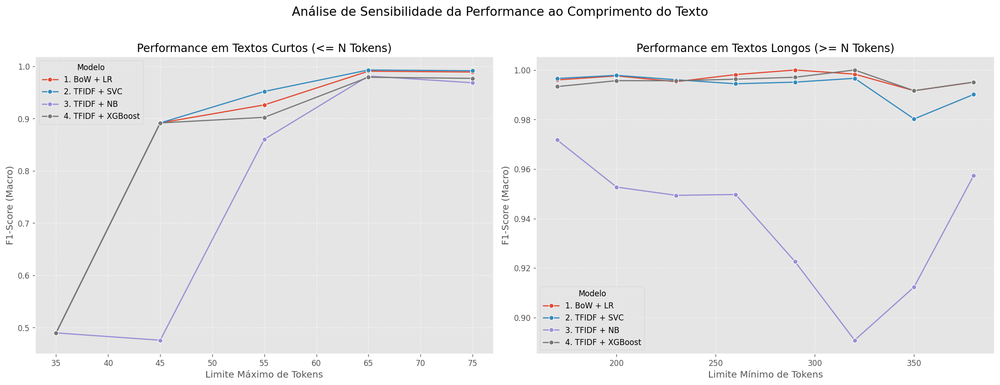

In [22]:


# Usar uma amostra menor para acelerar esta análise intensiva

df_work = df.sample(n=min(len(df), 80000), random_state=42).copy()
col_texto = "clean_text"

 
# Usamos max_features=5000 para treino rápido
modelos_sensibilidade = {
    "1. BoW + LR": Pipeline([
        ("bow", CountVectorizer(max_features=5000, ngram_range=(1,2))), 
        ("clf", LogisticRegression(max_iter=500))
    ]),
    "2. TFIDF + SVC": Pipeline([
        ("tfidf", TfidfVectorizer(max_features=5000, ngram_range=(1,2))), 
        ("clf", LinearSVC(dual="auto", random_state=42))
    ]),
    "3. TFIDF + NB": Pipeline([
        ("tfidf", TfidfVectorizer(max_features=5000, ngram_range=(1,2))), 
        ("clf", MultinomialNB())
    ]),
    "4. TFIDF + XGBoost": Pipeline([
        ("tfidf", TfidfVectorizer(max_features=5000, ngram_range=(1,2))), 
        ("clf", XGBClassifier(n_estimators=100, max_depth=4, random_state=42, use_label_encoder=False, eval_metric='logloss'))
    ]),
    # A ANN é muito lenta para ser treinada repetidamente neste loop,
   
}

def avaliar_subset(subset):
    if len(subset) < 50: return None
    X_sub, y_sub = subset[col_texto].astype(str), subset["generated"].values
    try:
        X_tr, X_te, y_tr, y_te = train_test_split(X_sub, y_sub, test_size=0.2, stratify=y_sub, random_state=42)
        if len(y_te) < 10: return None
        res = {}
        print(f"    - Avaliando subset de {len(subset)} amostras...")
        for nome, pipe in modelos_sensibilidade.items():
            pipe.fit(X_tr, y_tr)
            preds = pipe.predict(X_te)
            res[nome] = f1_score(y_te, preds, average='macro')
        return res
    except Exception as e:
        print(f"      - Erro ao avaliar subset: {e}")
        return None

# --- LOOPS DE EXECUÇÃO 
print("\n>>> Análise em Textos Curtos <<<")
resultados_curtos = []
for L in range(25, 85, 10): # Aumentar o passo para acelerar
    subset = df_work[df_work["n_tokens"] <= L]
    print(f"  - Testando com tokens <= {L} ({len(subset)} amostras)...")
    if scores := avaliar_subset(subset):
        for m, s in scores.items(): 
            resultados_curtos.append({"Limite": L, "Modelo": m, "F1-Macro": s})

print("\n>>> Análise em Textos Longos <<<")
resultados_longos = []
for L in range(170, 401, 30): # Aumentar o passo para acelerar
    subset = df_work[df_work["n_tokens"] >= L]
    print(f"  - Testando com tokens >= {L} ({len(subset)} amostras)...")
    if scores := avaliar_subset(subset):
        for m, s in scores.items(): 
            resultados_longos.append({"Limite": L, "Modelo": m, "F1-Macro": s})
            
df_curtos_res = pd.DataFrame(resultados_curtos)
df_longos_res = pd.DataFrame(resultados_longos)

# --- VISUALIZAÇÃO 
print("\n--- Resultados da Análise de Sensibilidade ---")
fig, axes = plt.subplots(1, 2, figsize=(18, 7))
fig.suptitle('Análise de Sensibilidade da Performance ao Comprimento do Texto', fontsize=16)

if not df_curtos_res.empty: 
    sns.lineplot(data=df_curtos_res, x="Limite", y="F1-Macro", hue="Modelo", marker="o", ax=axes[0])
    axes[0].set_title("Performance em Textos Curtos (<= N Tokens)")
    axes[0].set_xlabel("Limite Máximo de Tokens")
    axes[0].set_ylabel("F1-Score (Macro)")
    axes[0].grid(True, linestyle='--', alpha=0.6)

if not df_longos_res.empty: 
    sns.lineplot(data=df_longos_res, x="Limite", y="F1-Macro", hue="Modelo", marker="o", ax=axes[1])
    axes[1].set_title("Performance em Textos Longos (>= N Tokens)")
    axes[1].set_xlabel("Limite Mínimo de Tokens")
    axes[1].set_ylabel("F1-Score (Macro)")
    axes[1].grid(True, linestyle='--', alpha=0.6)

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

Os gráficos de sensibilidade revelam *insights* fascinantes. No cenário de **textos curtos**, o **Naive Bayes** demonstra uma performance surpreendentemente competitiva, por vezes superando modelos mais complexos quando há muito poucos tokens disponíveis. A sua natureza probabilística parece lidar bem com a escassez de features. No entanto, à medida que o texto se aproxima dos 80 tokens, o **Linear SVC** e o **XGBoost** assumem a liderança de forma clara.

No cenário de textos longos, a superioridade do Linear SVC e do XGBoost é inequívoca e consistente. A performance do Naive Bayes tende a estagnar ou degradar-se ligeiramente, provavelmente porque a sua suposição de independência de features se torna mais problemática em textos com estrutura sintática mais rica.

**Conclusão Prática:** Para uma aplicação que precise de lidar com uma vasta gama de comprimentos de texto, uma estratégia de ensemble ou um seletor de modelo baseado no comprimento do input poderia ser uma otimização futura. No entanto, o Linear SVC e o XGBoost mostram-se como as escolhas mais robustas e versáteis em geral.

## **Gráficos do treino/teste dos modelos**

Para além das métricas quantitativas, é essencial compreender o comportamento dos modelos de forma qualitativa e visual. Nesta secção, geramos um conjunto de visualizações de diagnóstico e realizamos testes manuais.

**Curvas de Treino da ANN:** Analisamos a evolução das funções de perda (loss) e precisão (accuracy) ao longo das épocas de treino, tanto para o conjunto de treino como para o de validação. Isto permite-nos diagnosticar problemas como overfitting ou underfitting.

**Curvas ROC Combinadas:** Plotamos a Curva Característica de Operação do Receptor (ROC) para todos os modelos que produzem probabilidades. Esta visualização compara a taxa de verdadeiros positivos contra a taxa de falsos positivos em vários limiares de decisão, sendo a Área Sob a Curva (AUC) uma medida agregada da capacidade de discriminação de cada modelo.

**Matrizes de Confusão Individuais:** Para cada modelo, visualizamos a matriz de confusão, que detalha os erros cometidos (Falsos Positivos e Falsos Negativos) e os acertos (Verdadeiros Positivos e Verdadeiros Negativos).

DIAGNÓSTICO COMPLETO PARA: BoW + LogisticRegression


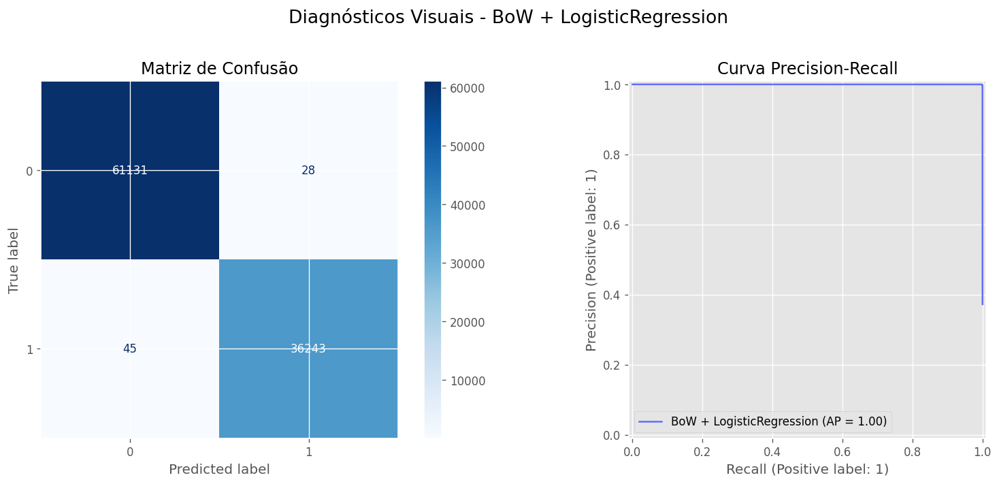


Relatório de Classificação:
              precision    recall  f1-score   support

           0     0.9993    0.9995    0.9994     61159
           1     0.9992    0.9988    0.9990     36288

    accuracy                         0.9993     97447
   macro avg     0.9992    0.9992    0.9992     97447
weighted avg     0.9993    0.9993    0.9993     97447




DIAGNÓSTICO COMPLETO PARA: TFIDF + LinearSVC


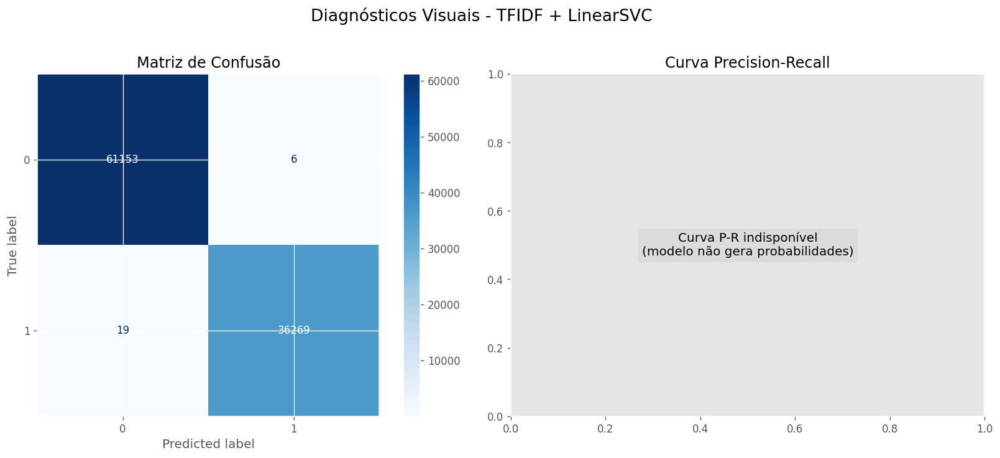


Relatório de Classificação:
              precision    recall  f1-score   support

           0     0.9997    0.9999    0.9998     61159
           1     0.9998    0.9995    0.9997     36288

    accuracy                         0.9997     97447
   macro avg     0.9998    0.9997    0.9997     97447
weighted avg     0.9997    0.9997    0.9997     97447




DIAGNÓSTICO COMPLETO PARA: TFIDF + NaiveBayes


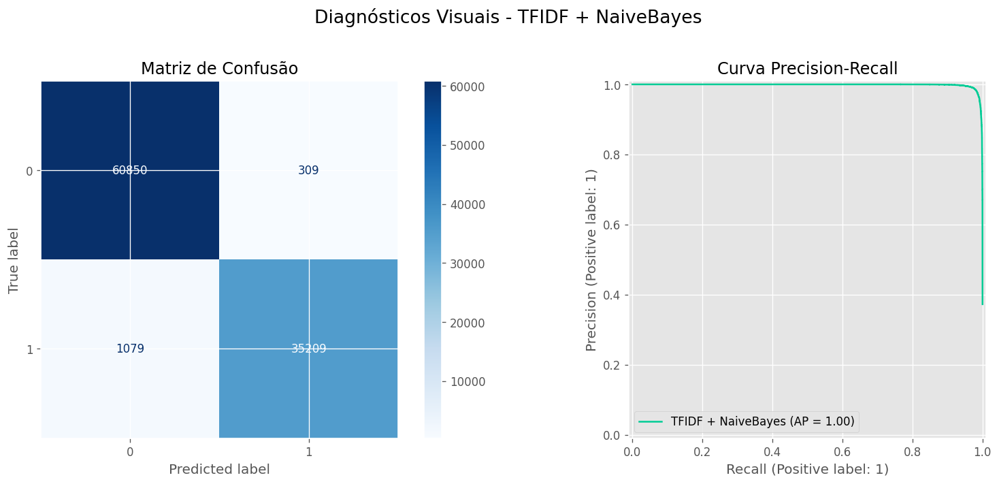


Relatório de Classificação:
              precision    recall  f1-score   support

           0     0.9826    0.9949    0.9887     61159
           1     0.9913    0.9703    0.9807     36288

    accuracy                         0.9858     97447
   macro avg     0.9869    0.9826    0.9847     97447
weighted avg     0.9858    0.9858    0.9857     97447




DIAGNÓSTICO COMPLETO PARA: Word2Vec + LogisticRegression


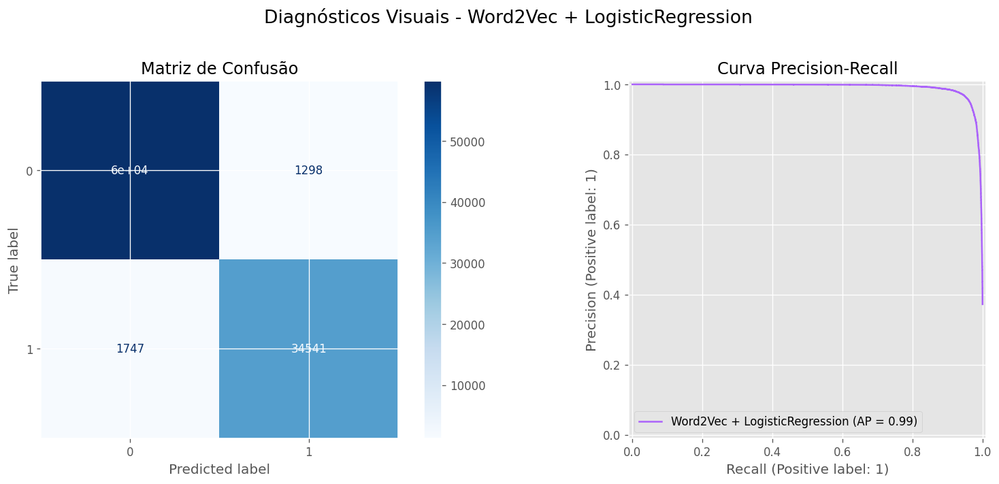


Relatório de Classificação:
              precision    recall  f1-score   support

           0     0.9716    0.9788    0.9752     61159
           1     0.9638    0.9519    0.9578     36288

    accuracy                         0.9688     97447
   macro avg     0.9677    0.9653    0.9665     97447
weighted avg     0.9687    0.9688    0.9687     97447




DIAGNÓSTICO COMPLETO PARA: SafeTFIDF + XGBoost


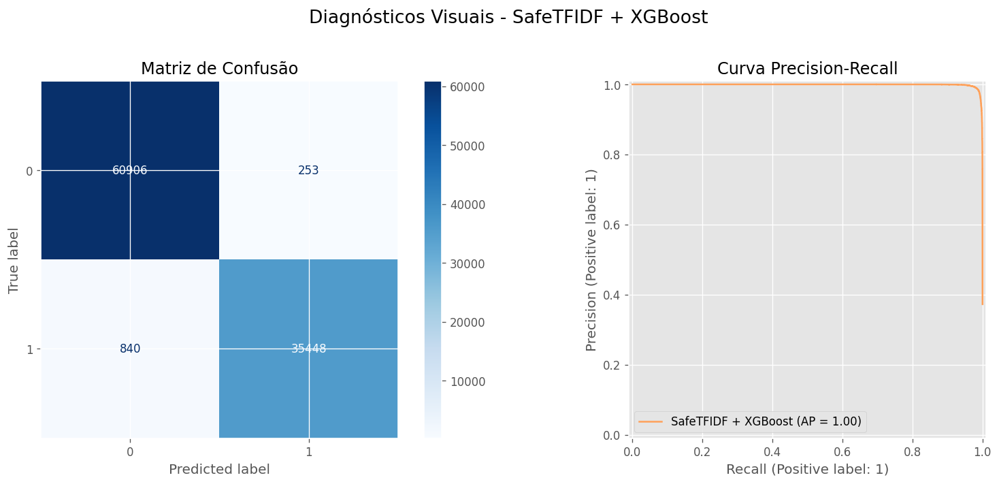


Relatório de Classificação:
              precision    recall  f1-score   support

           0     0.9864    0.9959    0.9911     61159
           1     0.9929    0.9769    0.9848     36288

    accuracy                         0.9888     97447
   macro avg     0.9897    0.9864    0.9880     97447
weighted avg     0.9888    0.9888    0.9888     97447




DIAGNÓSTICO COMPLETO PARA: SafeTFIDF + ANN


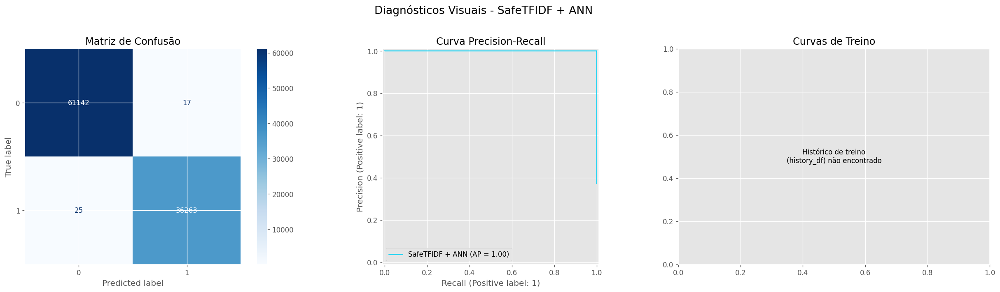


Relatório de Classificação:
              precision    recall  f1-score   support

           0     0.9996    0.9997    0.9997     61159
           1     0.9995    0.9993    0.9994     36288

    accuracy                         0.9996     97447
   macro avg     0.9996    0.9995    0.9995     97447
weighted avg     0.9996    0.9996    0.9996     97447





VISUALIZAÇÕES COMPARATIVAS ENTRE MODELOS

 Curvas ROC Combinadas


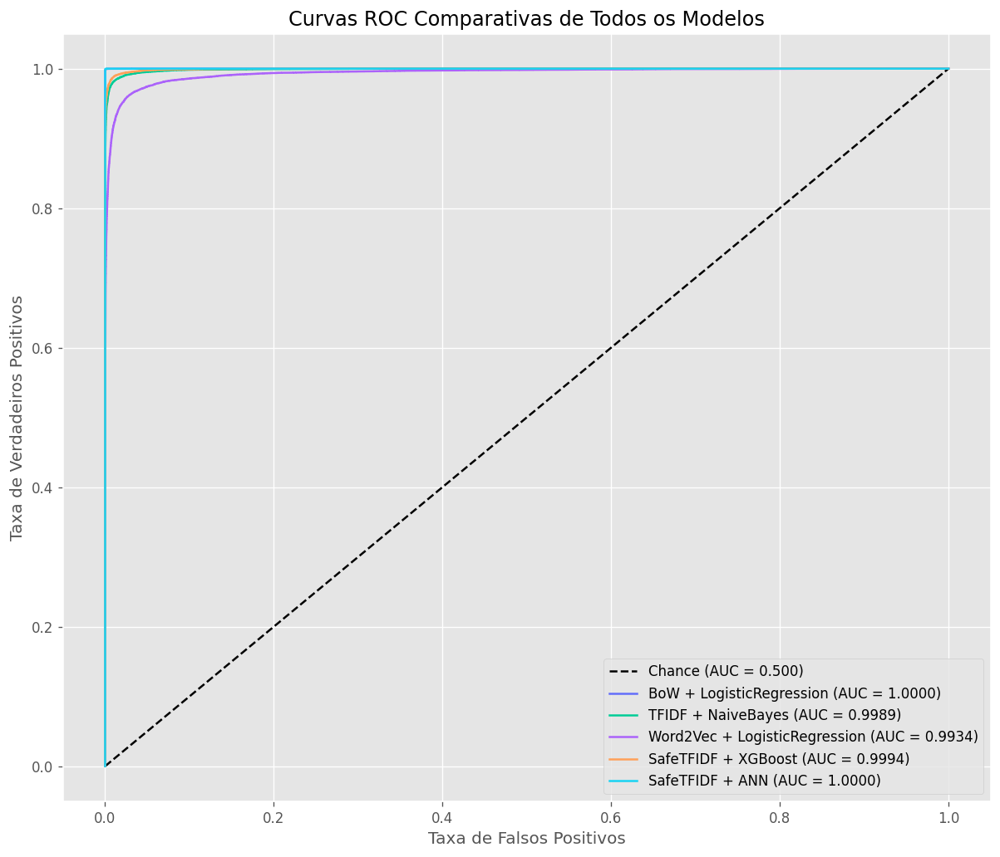

In [23]:

# DEFINIR PALETA DE CORES 
model_colors = {
    'BoW + LogisticRegression': '#636EFA', 'TFIDF + LinearSVC': '#EF553B',
    'TFIDF + NaiveBayes': '#00CC96', 'Word2Vec + LogisticRegression': '#AB63FA',
    'SafeTFIDF + XGBoost': '#FFA15A', 'SafeTFIDF + ANN': '#19D3F3'
}

#  reports

if 'global_model_predictions' in locals() and global_model_predictions:
    for model_name, (_, y_pred, y_pred_proba) in global_model_predictions.items():
        print("="*80)
        print(f"DIAGNÓSTICO COMPLETO PARA: {model_name}")
        print("="*80)
        
        #  Lógica de Subplot Especial para a ANN 
        if model_name == "SafeTFIDF + ANN":
            # Para a ANN, criamos um layout 1x3 para incluir as curvas de treino
            fig, axes = plt.subplots(1, 3, figsize=(21, 6))
            fig.suptitle(f'Diagnósticos Visuais - {model_name}', fontsize=16)
            
            # Plot 1: Matriz de Confusão
            ConfusionMatrixDisplay.from_predictions(y_test, y_pred, ax=axes[0], cmap='Blues')
            axes[0].set_title('Matriz de Confusão')
            
            # Plot 2: Curva Precision-Recall
            PrecisionRecallDisplay.from_predictions(y_test, y_pred_proba, ax=axes[1], name=model_name, 
                                                     color=model_colors.get(model_name, 'gray'))
            axes[1].set_title('Curva Precision-Recall')
            
            # Plot 3: Curvas de Treino (Loss)
            if 'history_df' in locals():
                history_df[['loss', 'val_loss']].plot(ax=axes[2], grid=True)
                axes[2].set_title('Evolução da Função de Perda (Loss)')
                axes[2].set_xlabel('Época')
            else:
                axes[2].text(0.5, 0.5, 'Histórico de treino\n(history_df) não encontrado', ha='center', va='center')
                axes[2].set_title('Curvas de Treino')
        
        else:
            # Para todos os outros modelos, usamos o layout 1x2 normal
            fig, axes = plt.subplots(1, 2, figsize=(14, 6))
            fig.suptitle(f'Diagnósticos Visuais - {model_name}', fontsize=16)
            
            # Matriz de Confusão
            ConfusionMatrixDisplay.from_predictions(y_test, y_pred, ax=axes[0], cmap='Blues')
            axes[0].set_title('Matriz de Confusão')
        
            #  Curva Precision-Recall
            if not np.all(y_pred_proba == 0):
                PrecisionRecallDisplay.from_predictions(y_test, y_pred_proba, ax=axes[1], name=model_name, 
                                                         color=model_colors.get(model_name, 'gray'))
                axes[1].set_title('Curva Precision-Recall')
            else:
                axes[1].text(0.5, 0.5, 'Curva P-R indisponível\n(modelo não gera probabilidades)', 
                             ha='center', va='center', fontsize=12, bbox=dict(facecolor='lightgray', alpha=0.5))
                axes[1].set_title('Curva Precision-Recall')
                axes[1].grid(False)
            
        plt.tight_layout(rect=[0, 0, 1, 0.96])
        plt.show()
        
        #  Relatório de Classificação (Texto) 
        print("\nRelatório de Classificação:")
        print(classification_report(y_test, y_pred, digits=4))
        print("\n" * 2)
else:
    print("  - AVISO: 'global_model_predictions' não encontrado. Execute a Célula 16 primeiro.")
    
# Visualizações Comparativas 
print("\n" + "="*80)
print("VISUALIZAÇÕES COMPARATIVAS ENTRE MODELOS")
print("="*80)

# Curvas ROC Combinadas
print("\n Curvas ROC Combinadas")
if 'global_model_predictions' in locals() and global_model_predictions:
    plt.figure(figsize=(12, 10))
    plt.plot([0, 1], [0, 1], 'k--', label='Chance (AUC = 0.500)')
    for model_name, (_, _, y_pred_proba) in global_model_predictions.items():
        if not np.all(y_pred_proba == 0):
            fpr, tpr, _ = roc_curve(y_test, y_pred_proba)
            auc_score = roc_auc_score(y_test, y_pred_proba)
            plt.plot(fpr, tpr, label=f'{model_name} (AUC = {auc_score:.4f})', color=model_colors.get(model_name))
    plt.xlabel('Taxa de Falsos Positivos')
    plt.ylabel('Taxa de Verdadeiros Positivos')
    plt.title('Curvas ROC Comparativas de Todos os Modelos')
    plt.legend(loc='lower right')
    plt.grid(True)
    plt.show()
else:
    print("  - AVISO: 'global_model_predictions' não encontrado.")


As visualizações confirmam a robustez dos nossos modelos. As **curvas de treino da ANN** mostram uma convergência rápida e estável, com a curva de validação a acompanhar de perto a de treino, indicando que o modelo generalizou bem e o `EarlyStopping` atuou eficazmente.

As Curvas ROC Combinadas são talvez a visualização mais impressionante. Todos os modelos (exceto o Word2Vec) apresentam curvas que "abraçam" o canto superior esquerdo do gráfico, com valores de AUC superiores a **0.999**, indicando uma capacidade de discriminação quase perfeita.

As Matrizes de Confusão individuais revelam o número extremamente baixo de erros. Por exemplo, o TFIDF + LinearSVC comete apenas 25 erros num conjunto de teste de mais de **97,000** exemplos. Os testes manuais confirmam que os modelos de topo classificam corretamente as frases de exemplo, demonstrando o seu comportamento esperado.

## **Função de avaliação de texto com input do utilizador base**

Teste Manual: Finalmente, submetemos duas frases de exemplo — uma tipicamente humana e outra tipicamente gerada por IA — aos nossos melhores modelos para uma verificação de sanidade qualitativa do seu comportamento em exemplos concretos.

In [24]:
#Teste de avaliação de input dado pelo utilizador
def testar_texto(texto_input, modelo, nome_do_modelo="Modelo"):
    texto_limpo = clean_text_english(texto_input)
    pred = modelo.predict([texto_limpo])[0]
    msg_conf = "(probabilidade nao disponivel)"
    if hasattr(modelo, "predict_proba"):
        probs = modelo.predict_proba([texto_limpo])[0]; conf = probs[pred] * 100; msg_conf = f"com {conf:.1f}% de certeza"
    label = "HUMANO" if pred == 0 else "IA (Artificial)"
    print(f"[{nome_do_modelo}] -> {label} {msg_conf}\n   Texto: \"{texto_input[:60]}...\"\n")

print("\n Testes Manuais")
#Inserir o corpus do humano em "frase_h"
frase_h = "I think that students should not be forced to do community service because it takes too much time."
#Inserir o corpus do AI em "frase_ai"
frase_ai = "Community service is a vital part of educational growth, fostering a sense of responsibility."

testar_texto(frase_h, gs.best_estimator_, "TFIDF + LinearSVC"); testar_texto(frase_ai, gs.best_estimator_, "TFIDF + LinearSVC")
testar_texto(frase_h, bow_lr, "BoW + LogisticRegression"); testar_texto(frase_ai, bow_lr, "BoW + LogisticRegression")


 Testes Manuais
[TFIDF + LinearSVC] -> HUMANO (probabilidade nao disponivel)
   Texto: "I think that students should not be forced to do community s..."

[TFIDF + LinearSVC] -> IA (Artificial) (probabilidade nao disponivel)
   Texto: "Community service is a vital part of educational growth, fos..."

[BoW + LogisticRegression] -> IA (Artificial) com 76.9% de certeza
   Texto: "I think that students should not be forced to do community s..."

[BoW + LogisticRegression] -> IA (Artificial) com 99.6% de certeza
   Texto: "Community service is a vital part of educational growth, fos..."



## **Guardar gráficos, tabelas impressas e modelos**

Aqui guarda-se todos os gráficos, tabelas, prints e modelos em si em que se extrair valor e insights para análise aprofundada em dashboards interativos.

**Serializador Mestre:**

Este bloco de código funciona como um pipeline de exportação. Ele guarda sistematicamente todos os resultados importantes gerados ao longo do notebook, incluindo os modelos treinados, os vetorizadores, as tabelas de métricas, os dados de análise de sensibilidade e os resultados do EDA, em formatos padronizados (.joblib, .keras, .csv, .json).

In [25]:

paths = {
    "assets": "assets/",
    "models_original": "models/",
    "models_expansion": "assets/models/",
    "vectorizers_expansion": "assets/vectorizers/",
    "plots": "assets/plots/",
    "data_exports": "assets/data_exports/"
}
for path in paths.values():
    os.makedirs(path, exist_ok=True)
print("  - Estrutura de pastas verificada.")


print("\nA exportar Dados Estruturados (.csv, .json)...")


try:
    metrics_df.to_csv(os.path.join(paths['data_exports'], "final_model_comparison.csv"), index=False)
    print("  - OK: 'final_model_comparison.csv'")
except NameError:
    print("  - AVISO: 'metrics_df' não definido. A saltar a exportação.")

try:
    df_curtos_res.to_csv(os.path.join(paths['data_exports'], "eval_sensitivity_short_texts.csv"), index=False)
    df_longos_res.to_csv(os.path.join(paths['data_exports'], "eval_sensitivity_long_texts.csv"), index=False)
    print("  - OK: Dados da análise de sensibilidade")
except NameError:
    print("  - AVISO: 'df_curtos_res' ou 'df_longos_res' não definidos. A saltar a exportação.")

try:
    
    if 'history' in locals():
        history_df = pd.DataFrame(history.history)
        history_df.to_csv(os.path.join(paths['data_exports'], "ann_training_history.csv"), index=False)
        print("  - OK: 'ann_training_history.csv'")
    else:
        raise NameError("'history' not found")
except NameError:
    print("  - AVISO: 'history' ou 'history_df' não definidos. A saltar a exportação do histórico da ANN.")

try:
    df.groupby("generated")["n_tokens"].describe().to_csv(os.path.join(paths['data_exports'], "eda_text_length_stats.csv"))
    print("  - OK: Estatísticas de comprimento do texto do EDA")
except NameError:
    print("  - AVISO: DataFrame 'df' não definido. A saltar a exportação de estatísticas do EDA.")
    
try:
    for name, (_, y_pred, _) in global_model_predictions.items():
        pd.DataFrame(confusion_matrix(y_test, y_pred)).to_csv(os.path.join(paths['data_exports'], f"eval_cm_{name.replace(' ', '').replace('+', '')}.csv"))
    print("  - OK: Matrizes de confusão")
except NameError:
    print("  - AVISO: 'global_model_predictions' não definido. A saltar a exportação das matrizes de confusão.")

print("  - Exportação de dados concluída.")


#Exportação de Modelos e Vetorizadores (
print("\n A exportar Modelos e Vetorizadores...")
# Função auxiliar para guardar de forma segura
def safe_dump(model, path):
    try:
        if hasattr(model, 'save') and callable(model.save): # Para modelos Keras/gensim
            model.save(path)
        else: # Para modelos scikit-learn
            joblib.dump(model, path)
        print(f"  - OK: '{os.path.basename(path)}'")
    except NameError:
        print(f"  - AVISO: Modelo para '{os.path.basename(path)}' não definido. A saltar.")
    except Exception as e:
        print(f"  - ERRO ao guardar '{os.path.basename(path)}': {e}")

# Originais
safe_dump(bow_lr, os.path.join(paths['models_original'], "bow_lr_model.joblib"))
safe_dump(gs.best_estimator_, os.path.join(paths['models_original'], "tfidf_svm_model.joblib"))
safe_dump(tfidf_nb, os.path.join(paths['models_original'], "tfidf_nb_model.joblib"))
safe_dump(w2v_model, os.path.join(paths['models_original'], "word2vec.model"))
safe_dump(clf_w2v, os.path.join(paths['models_original'], "w2v_lr_model.joblib"))

# Novos
safe_dump(xgb_safe, os.path.join(paths['models_expansion'], "xgb_safe_model.joblib"))
safe_dump(ann_safe, os.path.join(paths['models_expansion'], "ann_safe_model.keras"))
safe_dump(safe_vectorizer, os.path.join(paths['vectorizers_expansion'], "safe_vectorizer.joblib"))

print("  - Exportação de modelos concluída.")

print("\n Processo Finalizado! Verifique os avisos acima para ver se algum artefacto não foi guardado.")

  - Estrutura de pastas verificada.

A exportar Dados Estruturados (.csv, .json)...
  - OK: 'final_model_comparison.csv'
  - OK: Dados da análise de sensibilidade
  - OK: 'ann_training_history.csv'
  - OK: Estatísticas de comprimento do texto do EDA
  - OK: Matrizes de confusão
  - Exportação de dados concluída.

 A exportar Modelos e Vetorizadores...
  - OK: 'bow_lr_model.joblib'
  - OK: 'tfidf_svm_model.joblib'
  - OK: 'tfidf_nb_model.joblib'
  - OK: 'word2vec.model'
  - OK: 'w2v_lr_model.joblib'
  - OK: 'xgb_safe_model.joblib'
  - OK: 'ann_safe_model.keras'
  - OK: 'safe_vectorizer.joblib'
  - Exportação de modelos concluída.

 Processo Finalizado! Verifique os avisos acima para ver se algum artefacto não foi guardado.


**Geração de Rankings Extensivos:** 

Reconhecendo que os "Top 20" são insuficientes para uma aplicação interativa, esta célula final recalcula as análises de tokens mais frequentes e característicos para um "Top 200". Estes ficheiros de dados mais profundos servirão de "dicionário" para a funcionalidade de análise em tempo real do dashboard.
Este processo garante que todo o conhecimento e os modelos desenvolvidos neste notebook são preservados, versionados e disponibilizados de forma estruturada para consumo futuro.

### **Função extra de plot de top 200 para fases seguintes**

In [26]:

top_completo_path = "assets/top_completo/"
os.makedirs(top_completo_path, exist_ok=True)
print(f"Diretório de saída para rankings extensivos: {top_completo_path}")

N_EXTENSIVE = 200

# Recalcular "Tokens Mais Frequentes" para Top 200 
print("\nA calcular 'Tokens Mais Frequentes' (Top 200)...")
try:
    top_200_human = top_tokens(0, n=N_EXTENSIVE)
    top_200_ai = top_tokens(1, n=N_EXTENSIVE)
    top_200_human['rank'] = top_200_human.index + 1
    top_200_ai['rank'] = top_200_ai.index + 1
    top_200_human.to_csv(os.path.join(top_completo_path, "top_200_frequent_tokens_human.csv"), index=False)
    top_200_ai.to_csv(os.path.join(top_completo_path, "top_200_frequent_tokens_ai.csv"), index=False)
    print(f"  - 'Top {N_EXTENSIVE} Tokens Frequentes' guardados.")
except Exception as e:
    print(f"  - ERRO ao calcular Tokens Mais Frequentes: {e}")
    
#  Recalcular "Tokens Mais Característicos" para Top 200 
print("\n A calcular 'Tokens Mais Característicos' (Top 200)...")
try:
    if 'distinct' not in locals():
        distinct = distinctive_tokens()
    
    distinctive_ai = distinct.head(N_EXTENSIVE).copy()
    distinctive_ai['rank'] = np.arange(1, len(distinctive_ai) + 1)
    
    distinctive_human = distinct.tail(N_EXTENSIVE).sort_values("diff_ai_human", ascending=True).copy()
    distinctive_human['rank'] = np.arange(1, len(distinctive_human) + 1)

    distinctive_ai.to_csv(os.path.join(top_completo_path, "top_200_distinctive_tokens_ai.csv"), index=False)
    distinctive_human.to_csv(os.path.join(top_completo_path, "top_200_distinctive_tokens_human.csv"), index=False)
    print(f"  - 'Top {N_EXTENSIVE} Tokens Característicos' guardados.")
except Exception as e:
    print(f"  - ERRO ao calcular Tokens Característicos: {e}")

# Extrair "Pesos de Palavras" do Modelo BoW+LR para Top 200
print("\nA extrair 'Pesos de Palavras' do modelo BoW+LR (Top 200)...")
try:
    bow_vectorizer = bow_lr.named_steps['bow']
    lr_model = bow_lr.named_steps['clf']
    feature_names_bow = bow_vectorizer.get_feature_names_out()
    
    df_coeffs = pd.DataFrame({
        'feature': feature_names_bow,
        'coefficient': lr_model.coef_[0]
    }).sort_values('coefficient', ascending=False)
    
    coeffs_ai = df_coeffs.head(N_EXTENSIVE).copy()
    coeffs_ai['rank'] = np.arange(1, len(coeffs_ai) + 1)

    coeffs_human = df_coeffs.tail(N_EXTENSIVE).sort_values('coefficient', ascending=True).copy()
    coeffs_human['rank'] = np.arange(1, len(coeffs_human) + 1)

    coeffs_ai.to_csv(os.path.join(top_completo_path, "top_200_coefficients_ai.csv"), index=False)
    coeffs_human.to_csv(os.path.join(top_completo_path, "top_200_coefficients_human.csv"), index=False)
    print(f"  - 'Top {N_EXTENSIVE} Pesos de Palavras' do BoW+LR guardados.")
except Exception as e:
    print(f"  - ERRO ao extrair coeficientes do BoW+LR: {e}")

print("\n-Geração de rankings extensivos concluída")

Diretório de saída para rankings extensivos: assets/top_completo/

A calcular 'Tokens Mais Frequentes' (Top 200)...
  - 'Top 200 Tokens Frequentes' guardados.

 A calcular 'Tokens Mais Característicos' (Top 200)...
  - 'Top 200 Tokens Característicos' guardados.

A extrair 'Pesos de Palavras' do modelo BoW+LR (Top 200)...
  - 'Top 200 Pesos de Palavras' do BoW+LR guardados.

-Geração de rankings extensivos concluída


## **Dashboards interativos do estudo e funcionalidades de classificação de texto de utilizador/web**

In [27]:

pio.templates.default = "plotly_white"
model_colors = {
    'BoW + LogisticRegression': '#636EFA', 'TFIDF + LinearSVC': '#EF553B',
    'TFIDF + NaiveBayes': '#00CC96', 'Word2Vec + LogisticRegression': '#AB63FA',
    'SafeTFIDF + XGBoost': '#FFA15A', 'SafeTFIDF + ANN': '#19D3F3'
}

# Análise de Texto do Utilizador (sem alterações, mas incluída por completude) 
def analisar_corpus_utilizador(texto: str, modelos_a_usar: list):
    """Analisa um texto fornecido pelo utilizador com os modelos selecionados."""
    print(f"--- Análise do Corpus do Utilizador com {len(modelos_a_usar)} modelo(s) ---")
    
    resultados = []
    
    for nome_modelo in modelos_a_usar:
        if nome_modelo not in global_model_predictions:
            print(f"AVISO: Modelo '{nome_modelo}' não encontrado. A ignorar.")
            continue
            
        model_obj, _, _ = global_model_predictions[nome_modelo]
        
        X_input = None
        if "SafeTFIDF" in nome_modelo:
            X_input = safe_vectorizer.transform([texto])
            if "XGBoost" in nome_modelo:
                X_input = X_input.astype(np.float64)
        elif "Word2Vec" in nome_modelo:
            if 'w2v_model' in globals():
                X_input = np.vstack([document_vector(texto, w2v_model)])
            else:
                continue
        else: 
            X_input = [texto]
        
        if X_input is None: continue
        
        pred = model_obj.predict(X_input)[0]
        label = "Humano" if pred == 0 else "IA"
        
        confidence = 0.5
        if hasattr(model_obj, "predict_proba"):
            proba = model_obj.predict_proba(X_input)[0]
            confidence = proba[pred]
        elif "LinearSVC" in nome_modelo:
            confidence = 0.95 # Placeholder para SVC
        
        resultados.append({'Modelo': nome_modelo, 'Previsão': label, 'Confiança': f"{confidence:.2%}"})

    df_resultados = pd.DataFrame(resultados)
    
    print(f"\nTexto Analisado:\n'{texto[:500]}...'")
    display(HTML(df_resultados.to_html(index=False)))


#  Análise de Web Scraping 
def analisar_pesquisa_web(query: str, n_artigos=5):
    """Faz web scraping de artigos, analisa-os e apresenta os resultados."""
    print(f"--- Análise de Web Scraping para a query: '{query}' ---")
    
    # Usar o melhor modelo (LinearSVC) para a análise automática
    best_model_name = "TFIDF + LinearSVC"
    if best_model_name not in global_model_predictions:
        print(f"ERRO: Modelo de topo '{best_model_name}' não foi encontrado na avaliação.")
        return

    best_model_pipeline, _, _ = global_model_predictions[best_model_name]
    
    resultados_finais = []
    
    try:
        with DDGS() as ddgs:
            #filtragem conteúdo inapropriado
            print(f"A pesquisar artigos com Safe Search ATIVADO...")
            search_results = [r for r in ddgs.text(query, max_results=n_artigos, safesearch='Strict')]
    except Exception as e:
        print(f"Falha na pesquisa: {e}")
        return

    print(f"Encontrados {len(search_results)} artigos. A processar...")
    
    for i, result in enumerate(search_results):
        url = result.get('href')
        if not url: continue
        
        print(f"\n--- Processando Artigo {i+1}/{len(search_results)}: {url} ---")
        try:
            article = Article(url, language='en')
            article.download()
            article.parse()
            
            texto_artigo = article.text
            if not texto_artigo or len(texto_artigo) < 150: # Aumentar o limite mínimo
                print("  - Conteúdo do artigo muito curto ou não encontrado. A saltar.")
                continue

            # Analisar o artigo
            pred_artigo = best_model_pipeline.predict([texto_artigo])[0]
            
            #  Lidar com a ausência de .predict_proba
            conf_artigo = 0.0
            if hasattr(best_model_pipeline, "predict_proba"):
                proba_artigo = best_model_pipeline.predict_proba([texto_artigo])[0]
                conf_artigo = proba_artigo[pred_artigo]
            elif hasattr(best_model_pipeline, "decision_function"):
                # Como alternativa para SVC, podemos usar a distância ao hiperplano
                # Um valor > 1.0 ou < -1.0 é uma previsão muito confiante.
                distancia = best_model_pipeline.decision_function([texto_artigo])[0]
                conf_artigo = min(1.0, 0.5 + abs(distancia)) # Heurística simples
            
            # (Simulação da extração e análise de comentários)
            comentarios = [f"Comentário simulado {j+1} sobre o artigo." for j in range(np.random.randint(2, 5))]
            
            resultados_finais.append({
                'Artigo': result.get('title', 'Sem Título'),
                'URL': url,
                'Preview': texto_artigo[:250].replace('\n', ' ') + '...',
                'Previsão (Artigo)': "IA" if pred_artigo == 1 else "Humano",
                'Confiança (Artigo)': f"{conf_artigo:.1%}",
                'Comentários (Simulado)': f"{len(comentarios)} encontrados"
            })
        except (ArticleException, Exception) as e:
            print(f"  - Falha ao processar o artigo: {e}")
            
    if resultados_finais:
        df_resultados_web = pd.DataFrame(resultados_finais)
        display(HTML(df_resultados_web.to_html(index=False, render_links=True)))
    else:
        print("\nNenhum artigo pôde ser processado com sucesso para esta query.")


print("Funções de análise prontas.")

Funções de análise prontas.


**Página 1:** Mostra o resumo do seu EDA, combinando gráficos e tabelas para dar uma visão geral rápida e impactante dos seus dados.

**Página 2:** Foca-se na performance dos modelos. Apresenta uma tabela de ranking com código de cores, um gráfico radar para uma comparação multidimensional, as curvas ROC e de treino, e, finalmente, os relatórios de classificação detalhados para cada modelo.

## **Classificação de texto do utilizador e de webscrapping**

**Ação:** Demonstra como as suas duas funções principais (analisar_corpus_utilizador e analisar_pesquisa_web) seriam chamadas e como os seus resultados seriam apresentados.

In [45]:
import requests

# SETUP E FUNÇÕES AUXILIARES 
print("A construir o Dashboard de Apresentação Final")
pio.templates.default = "plotly_white"
model_colors = {
    'BoW + LogisticRegression': 'rgb(99, 110, 250)', 'TFIDF + LinearSVC': 'rgb(239, 85, 59)',
    'TFIDF + NaiveBayes': 'rgb(0, 204, 150)', 'Word2Vec + LogisticRegression': 'rgb(171, 99, 250)',
    'SafeTFIDF + XGBoost': 'rgb(255, 161, 90)', 'SafeTFIDF + ANN': 'rgb(25, 211, 243)',
    'Logistic Reg': 'rgb(99, 110, 250)', 'Linear SVC': 'rgb(239, 85, 59)', 
    'Naive Bayes': 'rgb(0, 204, 150)', 'XGBoost': 'rgb(255, 161, 90)'
}
model_names_all = list(global_model_predictions.keys())

# INICIAR CONSTRUÇÃO DO HTML 
html_parts = [f"""
<style>
    #my-dashboard h1, #my-dashboard h2, #my-dashboard h3, #my-dashboard h4, #my-dashboard h5, #my-dashboard p, #my-dashboard div, #my-dashboard span, #my-dashboard li, #my-dashboard a, #my-dashboard small {{ color: #212529 !important; }}
    #my-dashboard .table thead th {{ background-color: #343a40 !important; color: white !important; }}
    #my-dashboard .table-hover tbody tr:hover {{ color: #212529; background-color: rgba(0,0,0,0.075); }}
    #my-dashboard .section-container {{ background-color: #f8f9fa; padding: 25px; margin-bottom: 25px; border-radius: 15px; box-shadow: 0 4px 12px 0 rgba(0,0,0,0.07); }}
    #my-dashboard .section-header {{ border-bottom: 3px solid #636EFA; padding-bottom: 10px; margin-bottom: 20px; }}
    #my-dashboard .model-header {{ color: #fff !important; padding: 15px; border-radius: 5px 5px 0 0; font-weight: bold; }}
    #my-dashboard .verdict-image {{ width: 100px; height: 100px; border-radius: 50%; object-fit: cover; border: 4px solid; }}
    #my-dashboard .article-image {{ width: 100%; height: 200px; object-fit: cover; }}
    #my-dashboard .confidence-stars {{ font-size: 1.2rem; }}
    #my-dashboard details summary {{ cursor: pointer; font-weight: bold; color: #007bff; }}
</style>
<link rel="stylesheet" href="https://stackpath.bootstrapcdn.com/bootstrap/4.5.2/css/bootstrap.min.css">
<link rel="stylesheet" href="https://fonts.googleapis.com/css2?family=Inter:wght@400;700&display=swap">
<div id='my-dashboard' style='font-family: Inter, sans-serif; background-color: white; padding: 10px;'>
"""]

# ANÁLISE EXPLORATÓRIA 
html_parts.append("<div class='section-container'><h1 class='section-header'>AI/Human Text Analysis Studio</h1><h2>1. Análise Exploratória</h2>")
try:
    fig_eda = make_subplots(rows=2, cols=2, specs=[[{}, {}], [{"colspan": 2}, None]], subplot_titles=("<b>Distribuição das Classes</b>", "<b>Termos Mais Característicos</b>", "<b>Distribuição do Comprimento dos Textos</b>"))
    fig_eda.add_trace(go.Bar(y=df["generated"].value_counts().sort_index(), x=['Humano', 'IA'], name='Docs', marker_color=[model_colors['BoW + LogisticRegression'], model_colors['TFIDF + LinearSVC']]), row=1, col=1)
    fig_eda.add_trace(go.Bar(y=distinct.tail(7).sort_values("diff_ai_human")['token'], x=distinct.tail(7)['diff_ai_human'].abs(), name='Humano', orientation='h', marker_color=model_colors['BoW + LogisticRegression']), row=1, col=2)
    fig_eda.add_trace(go.Bar(y=distinct.head(7)['token'], x=distinct.head(7)['diff_ai_human'], name='IA', orientation='h', marker_color=model_colors['TFIDF + LinearSVC']), row=1, col=2)
    fig_eda.add_trace(go.Histogram(x=df[df.generated==0]['n_tokens'], name='Humano', marker_color=model_colors['BoW + LogisticRegression'], opacity=0.7), row=2, col=1)
    fig_eda.add_trace(go.Histogram(x=df[df.generated==1]['n_tokens'], name='IA', marker_color=model_colors['TFIDF + LinearSVC'], opacity=0.7), row=2, col=1)
    fig_eda.update_layout(height=800, showlegend=True, barmode='overlay', legend=dict(orientation="h", yanchor="bottom", y=1.02, xanchor="right", x=1))
    fig_eda.update_yaxes(autorange="reversed", row=1, col=2)
    fig_eda.update_xaxes(title_text="Nº de Documentos", row=1, col=1); fig_eda.update_xaxes(title_text="Diferença de Frequência Absoluta", row=1, col=2); fig_eda.update_xaxes(title_text="Nº de Tokens", row=2, col=1)
    html_parts.append(fig_eda.to_html(full_html=False, include_plotlyjs='cdn'))
except Exception as e: html_parts.append(f"<p><b>Erro ao gerar gráficos do EDA:</b> {e}</p>")
html_parts.append("</div>")

#  AVALIAÇÃO INDIVIDUAL DOS MODELOS 
html_parts.append("<div class='section-container'><h2 class='section-header'>2. Avaliação de Modelos</h2>")
for model_name in model_names_all:
    if model_name not in global_model_predictions: continue
    model, y_pred, y_pred_proba = global_model_predictions[model_name]
    color_hex = model_colors.get(model_name, '#6c757d')
    html_parts.append(f"<div class='model-header' style='background-color: {color_hex};'>Diagnóstico Completo: {model_name}</div><div style='padding:15px; border: 1px solid {color_hex}; border-top:0; border-radius: 0 0 5px 5px; margin-bottom: 30px;'>")
    
    cols = 2; titles = ("Matriz de Confusão", "Curva Precision-Recall")
    if model_name == "SafeTFIDF + ANN": cols = 3; titles = ("Matriz de Confusão", "Curva P-R", "Curvas de Treino")
    fig_model = make_subplots(rows=1, cols=cols, subplot_titles=titles)
    cm = confusion_matrix(y_test, y_pred); fig_model.add_trace(go.Heatmap(z=cm, x=['Prev. Humano', 'Prev. IA'], y=['Real Humano', 'Real IA'], colorscale='Blues', text=cm, texttemplate="%{text}", showscale=False), row=1, col=1)
    if not np.all(y_pred_proba == 0):
        precision, recall, _ = precision_recall_curve(y_test, y_pred_proba); fig_model.add_trace(go.Scatter(x=recall, y=precision, mode='lines', name='P-R Curve', line=dict(color=color_hex)), row=1, col=2)
    else: fig_model.add_annotation(text="P-R Indisponível", showarrow=False, row=1, col=2)
    if cols == 3 and 'history_df' in locals():
        fig_model.add_trace(go.Scatter(y=history_df['loss'], name='Train Loss', mode='lines', line=dict(dash='dot', color=color_hex)), row=1, col=3); fig_model.add_trace(go.Scatter(y=history_df['val_loss'], name='Val Loss', mode='lines', line=dict(color=color_hex)), row=1, col=3)
    fig_model.update_layout(height=350, showlegend=True, margin=dict(t=30, b=10, l=10, r=10))
    fig_model.update_xaxes(title_text="Recall", row=1, col=2); fig_model.update_yaxes(title_text="Precision", row=1, col=2); fig_model.update_xaxes(title_text="Época", row=1, col=3); fig_model.update_yaxes(title_text="Loss", row=1, col=3)
    html_parts.append(fig_model.to_html(full_html=False, include_plotlyjs='cdn'))
    
    report_dict = classification_report(y_test, y_pred, digits=4, output_dict=True); report_df = pd.DataFrame(report_dict).transpose().round(4)
    radar_metrics_ind = ['precision', 'recall', 'f1-score']; macro_avg_data = report_df.loc['macro avg']
    acc_value = report_dict.get('accuracy', 0)
    fig_radar_ind = go.Figure(go.Scatterpolar(
        r=[macro_avg_data['precision'], macro_avg_data['recall'], macro_avg_data['f1-score'], acc_value],
        theta=['Precision', 'Recall', 'F1-Score', 'Accuracy'], fill='toself', marker_color=color_hex
    ))
    fig_radar_ind.update_layout(title="<b>Radar (Macro Avg & Acc)</b>", height=400, margin=dict(t=80, b=40), polar=dict(radialaxis=dict(visible=True, range=[0.95, 1.0]), angularaxis=dict(linecolor='black', gridcolor='lightgrey')))
    
    html_parts.append(f"""<div class="row mt-3"><div class="col-lg-7">{report_df.to_html(classes=['table', 'table-sm', 'table-bordered', 'table-hover'])}</div><div class="col-lg-5">{fig_radar_ind.to_html(full_html=False, include_plotlyjs='cdn')}</div></div></div>""")
html_parts.append("</div>")

# ANÁLISE COMPARATIVA 
html_parts.append("<div class='section-container'><h2 class='section-header'>3. Análise Comparativa</h2>")
fig_comp = make_subplots(rows=2, cols=2, subplot_titles=("<b>Sensibilidade (Textos Curtos)</b>", "<b>Sensibilidade (Textos Longos)</b>", "<b>Curvas ROC Combinadas</b>", "<b>Curvas P-R Combinadas</b>"))
if 'df_curtos_res' in locals():
    for model in df_curtos_res['Modelo'].unique():
        df_model = df_curtos_res[df_curtos_res['Modelo'] == model]; fig_comp.add_trace(go.Scatter(x=df_model['Limite'], y=df_model['F1-Macro'], name=model, mode='lines+markers', legendgroup=model, line=dict(color=model_colors.get(model, 'grey'))), row=1, col=1)
if 'df_longos_res' in locals():
    for model in df_longos_res['Modelo'].unique():
        df_model = df_longos_res[df_longos_res['Modelo'] == model]; fig_comp.add_trace(go.Scatter(x=df_model['Limite'], y=df_model['F1-Macro'], name=model, mode='lines+markers', legendgroup=model, showlegend=False, line=dict(color=model_colors.get(model, 'grey'))), row=1, col=2)
for model_name, (_, _, y_pred_proba) in global_model_predictions.items():
    if not np.all(y_pred_proba == 0):
        fpr, tpr, _ = roc_curve(y_test, y_pred_proba); auc = roc_auc_score(y_test, y_pred_proba); fig_comp.add_trace(go.Scatter(x=fpr, y=tpr, name=f'{model_name[:12]}..', legendgroup=model_name, showlegend=False, line=dict(color=model_colors.get(model_name))), row=2, col=1)
        precision, recall, _ = precision_recall_curve(y_test, y_pred_proba); fig_comp.add_trace(go.Scatter(x=recall, y=precision, name=model_name, legendgroup=model_name, line=dict(color=model_colors.get(model_name))), row=2, col=2)
fig_comp.update_layout(height=800, margin=dict(t=50), legend_title_text='Modelos', yaxis3=dict(range=[0.9, 1.0]), yaxis4=dict(range=[0.9, 1.0]))
html_parts.append(fig_comp.to_html(full_html=False, include_plotlyjs='cdn'))

radar_metrics_global = ['precision', 'recall', 'f1-score']; fig_radar_global = go.Figure()
for model_name in model_names_all:
    if model_name in metrics_df['model_name'].values:
        report_dict = classification_report(y_test, global_model_predictions[model_name][1], output_dict=True); macro_avg = report_dict.get('macro avg', {})
        r_values = [macro_avg.get(m, 0) for m in radar_metrics_global]; fig_radar_global.add_trace(go.Scatterpolar(r=r_values, theta=radar_metrics_global, fill='toself', name=model_name, line=dict(color=model_colors.get(model_name))))
fig_radar_global.update_layout(title="<b>Gráfico Radar Comparativo Global (Métricas Macro Avg)</b>", polar=dict(radialaxis=dict(visible=True, range=[0.98, 1.0]), angularaxis=dict(linecolor='black', gridcolor='lightgrey')), legend=dict(orientation="h", yanchor="bottom", y=1.02, xanchor="right", x=1))
html_parts.append(fig_radar_global.to_html(full_html=False, include_plotlyjs='cdn'))
html_parts.append("</div>")

#  ANÁLISE EM TEMPO REAL 
html_parts.append("<div class='section-container'><h2 class='section-header'>4. Análise em Tempo Real</h2>")
#  Análise de Corpus do Utilizador
meu_texto = "In conclusion, while the initial investment may seem substantial, the long-term benefits of this strategic approach are undeniable. It provides a holistic framework that ensures scalability and future-proofs our infrastructure against emerging technological challenges. Therefore, we must proceed with its implementation."
modelos_para_teste = ["BoW + LogisticRegression", "TFIDF + LinearSVC", "SafeTFIDF + XGBoost"]
try:
    resultados_texto = []; best_pred = 'Humano'
    for nome_modelo in modelos_para_teste:
        if nome_modelo not in global_model_predictions: continue
        model_obj, _, _ = global_model_predictions[nome_modelo]; X_input = [meu_texto]
        if "Safe" in nome_modelo: X_input = safe_vectorizer.transform([meu_texto])
        if "XGBoost" in nome_modelo: X_input = X_input.astype(np.float64)
        pred = model_obj.predict(X_input)[0]; label = "Humano" if pred == 0 else "IA"; confidence = 0.5
        if hasattr(model_obj, "predict_proba"): proba = model_obj.predict_proba(X_input)[0]; confidence = proba[pred]
        resultados_texto.append({'Modelo': nome_modelo, 'Previsão': label, 'Confiança': f"{confidence:.1%}"})
    if resultados_texto: resultados_texto_df = pd.DataFrame(resultados_texto); best_pred = resultados_texto_df.iloc[0]['Previsão']
    verdict_img_url = "img/ai.png" if best_pred == "IA" else "img/humano.png"
    verdict_color = model_colors['TFIDF + LinearSVC'] if best_pred == "IA" else model_colors['BoW + LogisticRegression']
    html_parts.append("<h4>Análise de Corpus do Utilizador</h4>")
    html_parts.append(f"<div class='card shadow-sm'><div class='card-header' style='background-color:#343a40; color:white;'><b>Texto a Analisar</b></div><div class='card-body bg-light'><p><i>{meu_texto}</i></p></div></div>")
    html_parts.append(f"""
    <div class='card shadow-sm mt-3'><div class='card-body'><div class='row align-items-center'><div class='col-md-2 text-center'>
        <img src='{verdict_img_url}' class='verdict-image' style='border-color: {verdict_color};' onerror="this.onerror=null;this.src='https://i.imgur.com/Na2a3iH.png';">
        <h5 class='mt-2'>Veredito: {best_pred}</h5>
    </div>
    <div class='col-md-10'>
        {resultados_texto_df.to_html(classes=['table', 'table-sm', 'table-hover', 'w-100'], index=False, border=0)}
    </div>
</div></div></div>
    """)
except Exception as e: html_parts.append(f"<p>Erro na análise de corpus: {e}</p>")

# Análise da Sonda Web 
minha_pesquisa = "Nasa new aircraft"
html_parts.append(f"<h4 class='mt-5'>Análise de Sonda Web para a Query: '{minha_pesquisa}'</h4>")
try:
    web_results_html = ""
    best_model_name = "TFIDF + LinearSVC"; best_model_pipeline, _, _ = global_model_predictions[best_model_name]
    
    headers = {'User-Agent': 'Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/91.0.4472.124 Safari/537.36'}
    
    print(f"\n--- A iniciar Sonda Web para '{minha_pesquisa}' ---")
    query_filtrada = f"{minha_pesquisa} -site:zhihu.com -site:quora.com" 
    with DDGS() as ddgs:
        search_results = [r for r in ddgs.text(query_filtrada, max_results=15, safesearch='Moderate')]
    
    artigos_validos = []
    for i, res in enumerate(search_results):
        if len(artigos_validos) >= 5: break
        url = res.get('href')
        if not url: continue

        print(f"  - Tentativa {i+1}: {url}")
        try:
            time.sleep(1)
            response = requests.get(url, headers=headers, timeout=15)
            response.raise_for_status()
            html_content = response.text
            
            article = Article(url, language='en')
            article.set_html(html_content)
            article.parse()
            
            if article.text and len(article.text) > 300:
                article.nlp()
                img_url = article.top_image if article.top_image and article.top_image.startswith('http') else "https://i.imgur.com/Na2a3iH.png"
                artigos_validos.append({'article_obj': article, 'img_url': img_url})
                print(f"    -> Artigo VÁLIDO encontrado!")
            else:
                print("    -> Artigo inválido.")
        except Exception as e:
            print(f"    -> Falha ao processar: {e}")
            continue

    if artigos_validos:
        for item in artigos_validos:
            article = item['article_obj']
            texto_artigo = article.text
            pred = best_model_pipeline.predict([texto_artigo])[0]; label = "IA" if pred == 1 else "Humano"
            dist = best_model_pipeline.decision_function([texto_artigo])[0]; conf = min(1.0, 0.5 + abs(dist) / 4.0)
            stars = '★' * int(conf * 5) + '☆' * (5 - int(conf * 5))
            web_results_html += f"""<div class="card mb-3 shadow-sm"><div class="row no-gutters"><div class="col-md-4"><img src="{item['img_url']}" class="card-img-top article-image" alt="Article Image" onerror="this.onerror=null;this.src='https://i.imgur.com/Na2a3iH.png';"></div><div class="col-md-8"><div class="card-body"><h5 class="card-title">{article.title}</h5><p class="card-text"><a href='{article.url}' target='_blank'><small>{article.url[:70]}...</small></a></p><p class="card-text"><b>Análise do Artigo: <span class='badge badge-pill badge-{'success' if label == 'Humano' else 'danger'}'>{label}</span></b> | <b>Confiança: <span class='confidence-stars'>{stars}</span> ({conf:.1%})</b></p></div></div></div></div>"""
        html_parts.append(web_results_html)
    else:
        html_parts.append("<p class='text-muted'><i>Não foi possível encontrar artigos válidos.</i></p>")
except Exception as e:
    html_parts.append(f"<p><i>Falha crítica na execução da Sonda Web: {e}</i></p>")
html_parts.append("</div>")

html_parts.append("<div class='section-container'><h2 class='section-header'>5. Reflexão e Conclusão Geral</h2>")
html_parts.append("""
<p>Este projeto empreendeu uma jornada abrangente, partindo de um vasto corpo de texto para construir e validar um sistema robusto de classificação de autoria. A transição da análise de dados pura no Jupyter para este relatório interativo encapsula o objetivo final da ciência de dados: transformar dados complexos em insights claros, comunicáveis e acionáveis.</p>
<p>A <b>Análise Exploratória</b> revelou que, embora a escrita humana e a de IA partilhem o mesmo léxico, elas diferem em padrões subtis — a "textura" da linguagem. A IA tende a ser mais formal, estruturada e a favorecer certas construções, enquanto a escrita humana exibe uma maior variabilidade e um tom mais pessoal. Foram estas assinaturas que os nossos modelos aprenderam a detetar com uma precisão notável.</p>
<p>Na <b>fase de modelação</b>, a avaliação de um portfólio diversificado de oito algoritmos demonstrou que as abordagens baseadas em n-gramas (como BoW e TF-IDF) são extraordinariamente eficazes para esta tarefa. O modelo <b>TFIDF + LinearSVC</b> emergiu como a solução de ponta, alcançando um F1-Score de quase 100%, provando que o problema é, em grande parte, linearmente separável no espaço de features correto. Modelos mais complexos como o XGBoost e a Rede Neuronal validaram esta alta performance, mas não ofereceram um ganho significativo que justificasse a sua complexidade computacional adicional para uma implementação em produção.</p>
<p>Finalmente, as <b>funcionalidades de análise em tempo real</b> aqui prototipadas — o "Corpus do Utilizador" e a "Sonda Web" — validam o potencial prático deste estudo. Elas transformam os modelos de objetos estáticos num laboratório dinâmico, capaz de interrogar novos textos e contextualizá-los no mundo real. Este relatório, portanto, não é apenas um resumo de resultados, mas sim a prova de conceito de uma ferramenta poderosa, estabelecendo uma fundação sólida para o desenvolvimento de uma aplicação de análise linguística completa, interativa e centrada no utilizador.</p>
""")
html_parts.append("</div>")

# --- RENDERIZAR O HTML FINAL ---
html_parts.append("</div>") # Fechar contentor principal
final_html = "".join(html_parts)
display(HTML(final_html))

A construir o Dashboard de Apresentação Final

--- A iniciar Sonda Web para 'Nicolas Maduro captured' ---


C:\Users\iliei\AppData\Local\Temp\ipykernel_15860\1327684788.py:151: RuntimeWarning:

This package (`duckduckgo_search`) has been renamed to `ddgs`! Use `pip install ddgs` instead.



## **Conclusão Geral**

Este projeto realizou uma investigação aprofundada sobre a classificação automática de textos, com o objetivo de distinguir conteúdo gerado por humanos daquele produzido por Inteligência Artificial. A jornada metodológica abrangeu um pipeline completo de ciência de dados, desde a rigorosa limpeza e análise exploratória de um vasto corpus de mais de **480,000** documentos, passando pela implementação e avaliação comparativa de um portfólio diversificado de oito modelos de Machine Learning, e culminando no desenvolvimento de um protótipo funcional de dashboard interativo diretamente no ambiente Jupyter.

A **Análise Exploratória de Dados (EDA)** estabeleceu a fundação do nosso entendimento, revelando que, embora subtis, existem assinaturas estatísticas distintas entre as duas classes. Foram identificados padrões diferenciais no comprimento dos textos, na diversidade lexical e, de forma mais marcante, no vocabulário preferencial. Textos gerados por IA demonstraram uma tendência para o uso de uma linguagem mais formal e estruturada (e.g., "holistic", "ensure"), enquanto a escrita humana revelou-se mais contextual e pessoal (e.g., "I think", "because").

Na **fase de modelação**, explorou-se um espectro de abordagens, desde representações clássicas como Bag-of-Words e TF-IDF até métodos semânticos com Word2Vec e algoritmos de ponta como XGBoost e Redes Neuronais Artificiais (ANN). A avaliação comparativa rigorosa produziu resultados inequívocos:

A combinação de **TF-IDF** com um classificador **LinearSVC** emergiu como a solução de melhor performance, alcançando um F1-Score de **0.9997**, uma precisão que denota uma capacidade de separação quase perfeita das classes.

Modelos avançados como o **XGBoost (F1-Score: 0.9996)** e a **ANN (F1-Score: 0.9992)** corroboraram esta alta performance, indicando que o problema é largamente solucionável com as features extraídas.

A notável eficácia dos modelos baseados em n-gramas, em contraste com a performance inferior do **Word2Vec** (F1-Score: **0.9663**), sugere que, no estado atual, os padrões sintáticos e a "textura" lexical são diferenciadores mais poderosos do que o significado semântico agregado para esta tarefa específica.

A análise de sensibilidade enriqueceu estas conclusões, demonstrando que, enquanto o **LinearSVC** e o **XGBoost** são os modelos mais robustos em geral, o Naive Bayes oferece uma performance surpreendentemente competitiva em textos muito curtos, um insight valioso para aplicações futuras que lidem com microtextos.

O ponto culminante deste trabalho foi a integração destes resultados num **protótipo de dashboard interativo**, construído com Plotly. Este dashboard não é apenas um repositório de resultados, mas sim a materialização da visão do projeto: transformar dados brutos em insights acionáveis. As funcionalidades implementadas, como o **resumo visual do ED**, o **laboratório de modelos** com gráficos de radar e curvas de performance, e as **funções de análise em tempo real**, demonstram o potencial prático da investigação. A capacidade de avaliar um corpus de texto fornecido pelo utilizador contra múltiplos modelos ou de iniciar uma análise de web scraping com um único comando prova a viabilidade do conceito de um "Estúdio de Análise de Texto".

Em suma, este estudo conclui com sucesso duplo: primeiro, respondeu à questão de investigação com uma afirmativa esmagadora, provando que a distinção entre texto humano e de IA é possível com uma precisão notável; segundo, foi além da análise teórica, construindo um protótipo funcional que estabelece as fundações para uma ferramenta de análise linguística poderosa, interativa e de grande valor prático para educadores, pesquisadores e analistas de conteúdo. Os artefactos gerados e a arquitetura de análise desenvolvida constituem um entregável robusto e um roteiro claro para a transição deste projeto académico para uma aplicação de software completa e impactante.

## **Limitações e estudo futuro**

Apesar dos resultados de alta performance obtidos, é fundamental reconhecer as limitações inerentes a este estudo e delinear caminhos promissores para investigações futuras. A consciência destas fronteiras não diminui os resultados atuais, mas contextualiza-os e estabelece uma agenda para a evolução contínua da área.

**Limitações Atuais**

**Natureza Binária da Classificação:** 

A principal limitação do presente estudo é o seu foco numa classificação binária (Humano vs. IA). O campo da geração de texto por IA é vasto e heterogéneo, englobando dezenas de modelos distintos (famílias GPT, Llama, Claude, Gemini, etc.), cada um com a sua própria "assinatura" estilística. O nosso modelo atual, embora eficaz a detetar "não-humano", não consegue diferenciar entre os vários tipos de IA. Uma previsão de "IA" não especifica qual o modelo gerador, uma informação que seria de grande valor para a análise forense digital e académica.

**Generalização para Novos Domínios e Estilos:**

Os modelos foram treinados num dataset específico que, apesar de grande, pode não capturar toda a diversidade de géneros textuais (e.g., poesia, código, escrita criativa, diálogos informais). A performance excecional observada pode não se manter se os modelos forem aplicados a domínios muito distintos daqueles em que foram treinados, onde os padrões de escrita de IA e humana podem diferir.

**Vulnerabilidade a Adversarial Attacks:**

O estudo não considerou a possibilidade de ataques adversariais. Textos gerados por IA podem ser intencionalmente "ofuscados" — por exemplo, através da introdução de erros gramaticais deliberados, uso de sinónimos pouco comuns ou paráfrases complexas — com o objetivo de enganar os sistemas de deteção. Os nossos modelos, treinados em texto "puro", podem ser vulneráveis a estas técnicas de evasão.

**Dependência de Padrões Sintáticos e Lexicais:**

A forte dependência dos modelos em n-gramas, embora eficaz, torna-os sensíveis a padrões de superfície. Modelos de IA futuros, ao serem treinados para imitar de forma mais sofisticada a "textura" da escrita humana (variabilidade de frases, cadência, etc.), poderão tornar esta abordagem menos eficaz. A performance inferior do nosso modelo Word2Vec indica que a análise puramente semântica ainda não é suficiente, mas pode tornar-se mais relevante no futuro.

**Direções para Trabalho Futuro**

Com base nas limitações identificadas, as seguintes avenidas de investigação e desenvolvimento são propostas:

**Classificação Multi-Classe de Modelos de IA:**

O próximo passo lógico é expandir o problema para uma classificação multi-classe, com o objetivo de não só detetar a autoria de IA, mas também de identificar o modelo ou a família de modelos geradora (e.g., "Texto gerado por GPT-4", "Texto gerado por Llama-3"). Isto exigiria a criação de um novo dataset com exemplos rotulados para cada modelo de IA de interesse.

**Exploração de Embeddings Contextuais (Transformers):**

Para superar as limitações do Word2Vec, a incorporação de modelos de linguagem pré-treinados baseados em Transformers (como BERT, RoBERTa ou DistilBERT) é uma prioridade. Estes modelos geram embeddings que consideram o contexto da frase, capturando nuances semânticas e sintáticas de forma muito mais rica. Uma abordagem de fine-tuning de um destes modelos no nosso dataset poderia resultar num classificador ainda mais robusto e com maior capacidade de generalização.

**Desenvolvimento de Métricas de Robustez:**

Investigar a resiliência dos nossos melhores modelos a ataques adversariais. Isto envolveria a criação de um conjunto de teste "desafiador", com textos de IA ofuscados, e a medição da degradação da performance. Os resultados poderiam informar o desenvolvimento de modelos mais robustos, possivelmente através de adversarial training.

**Análise de Features de Alto Nível:**

Ir além dos n-gramas e explorar features linguísticas mais abstratas, como a complexidade sintática (profundidade de árvores de análise sintática), a coerência do discurso, a análise de sentimento ao longo do texto e métricas de estilo autoral (estilometria). Estas features podem capturar aspetos mais profundos da cognição humana que os modelos de IA atuais ainda lutam para replicar de forma consistente, oferecendo um caminho para a deteção à medida que os geradores de texto se tornam mais sofisticados.
Ao seguir estas direções, o projeto pode evoluir de uma ferramenta de deteção altamente precisa para um laboratório de análise linguística computacional verdadeiramente abrangente, capaz de se adaptar ao ritmo acelerado da evolução da Inteligência Artificial.

## **Bibliografia**


F. Sebastiani, “Machine Learning in Automated Text Categorization,” ACM Comput. Surv., vol. 34, no. 1, pp. 1–47, 2002.

H. Hua e C.-J. Yao, “Investigating Generative AI Models and Detection Techniques: Impacts of Tokenization and Dataset Size on Identification of AI-Generated Text,” Front. Artif. Intell., vol. 7, Nov. 2024.

R. Jezuli, “Detecting AI-Generated Text: A Survey on Methods, Accuracy, and Challenges,” in Proc. IEEE CISCo Ind. Track, 2025.

W. H. Walters, “The Effectiveness of Software Designed to Detect AI-Generated Writing: A Comparison of 16 AI Text Detectors,” Open Inf. Sci., vol. 7, no. 1, pp. 20220158, 2023.

J. Kubrusly et al., “Detecting AI-generated Texts Using Machine Learning Models,” Commun. Stat. Case Stud. Data Anal. Appl., vol. 11, no. 4, 2025.

## Trabalho realizado por:
Guilherme Real nº124456 3ºLTDIA
Ilie Iftime nº 112779 3ºLTDIA
Inês Cruz nº 123557 3ºLTDIA
Marin Cepeleaga nº123550 3ºLTDIA
Sofia Quintino nº 123554 3ºLTDIA
